<a href="https://colab.research.google.com/github/himasai97/GANs/blob/main/WGAN-GP/WGAN_GP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes

def tensor_image_viz(tensor_img, num_images=25, size=(1,28,28)):
  '''
  To visualize images
  Parameters: a tensor of images, number of images and size per image
  Output: prints the images in a uniform grid
  '''
  tensor_img = (tensor_img + 1) / 2
  image_unflat = tensor_img.detach().cpu()
  image_grid = make_grid(image_unflat[:num_images], nrow=5)
  plt.imshow(image_grid.permute(1,2,0).squeeze())
  plt.show()

def get_grad_hook():
  '''
  To keep track of gradients for visualization purposes.
  It fills the grads list when using model.apply(grad_hook).
      a hook function does not change the main body of the code 
      and implements additional functions
  '''
  grads = []
  def grad_hook(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
      grads.append(m.weight.grad)
  return grads, grad_hook

# Generator and Noise

In [2]:
class Generator(nn.Module):
  '''
  Generator Class with values:
      noise_dim: the dimension of the noise vector, a scalar
      img_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so here im_chan = 1)
      hidden_dim: the initial hidden layer output dimension, a scalar
  '''
  def __init__(self, noise_dim, img_chan=1, hidden_dim=64):
    super(Generator, self).__init__()
    self.noise_dim = noise_dim
    # building the neural network
    self.gen = nn.Sequential(
        self.get_gen_block(noise_dim, hidden_dim*4),
        self.get_gen_block(hidden_dim*4, hidden_dim*2, kernel_size=4, stride=1),
        self.get_gen_block(hidden_dim*2, hidden_dim),
        self.get_gen_block(hidden_dim, img_chan, kernel_size=4, final_layer=True),
    )
  
  def get_gen_block(self, in_chan, out_chan, kernel_size=3, stride=2, final_layer=False):
    '''
    To create a block of generator's neural network
    Parameters:
          in_chan: number of channels that the input feature for that layer has, a scalar
          out_chan: number of channels that the input feature for that layer should have, a scalar
          kernel_size: to determine the size of each convolution filter, equivalent to (kernel_size, kernel_size)
          stride: the amount by which the kernel is shifted when sliding across the input feature
          final_layer: a boolean indicating whether the given layer is the final layer (value is true in that case and false otherwise)
    Returns:
          a generator neural network layer consisting of:
            Transposed Convolution layer
            Batch Normalization (for stabilization)
            ReLU (a non linear transformation to transform the output)
          if final_layer:
            Transposed Convolution layer
            Tanh activation      
    '''
    if not final_layer:
      return nn.Sequential(
          nn.ConvTranspose2d(in_chan, out_chan, kernel_size, stride),
          nn.BatchNorm2d(out_chan),
          nn.ReLU(inplace=True),
      )
    else:
      return nn.Sequential(
          nn.ConvTranspose2d(in_chan, out_chan, kernel_size, stride),
          nn.Tanh(),
      )
  
  def forward(self, noise):
    '''
    To complete a forward pass of the generator after reshaping the noise vector
    Parameters:
        noise: a tensor with (n_samples, noise_dim) dimensions
    Returns:
        a batch of generated images
    '''
    x = noise.view(len(noise), self.noise_dim, 1, 1)
    return self.gen(x)

def get_noise(n_samples, noise_dim, device='cpu'):
  '''
  For creating noise vectors
  Parameters:
        n_samples: the number of samples to generate, a scalar
        noise_dim: the dimension of the noise vector, a scalar
        device: the device type
  Returns:
        a tensor filled with random numbers of (n_samples, noise_dim) dimension
  '''
  return torch.randn(n_samples, noise_dim, device=device)

# Critic
The WGAN relaxes the role of the discriminator when training a GAN and proposes the alternative of a critic

In [3]:
class Critic(nn.Module):
  '''
  Critic Class with values:
      img_chan: the number of channels that the output image has, a scalar
            (MNIST is black-and-white, so here img_chan=1)
      hidden_dim: the initial hidden layer output dimension, a scalar
  '''
  def __init__(self, img_chan=1, hidden_dim=64):
    super(Critic, self).__init__()
    self.crit = nn.Sequential(
        self.get_crit_block(img_chan, hidden_dim),
        self.get_crit_block(hidden_dim, hidden_dim*2),
        self.get_crit_block(hidden_dim*2, 1, final_layer=True),
    )
  
  def get_crit_block(self, in_chan, out_chan, kernel_size=4, stride=2, final_layer=False):
    '''
    To create a critic block of DCGAN
    Parameters:
          in_chan: number of channels that the input feature for that layer has, a scalar
          out_chan: number of channels that the input feature for that layer should have, a scalar
          kernel_size: to determine the size of each convolution filter, equivalent to (kernel_size, kernel_size)
          stride: the amount by which the kernel is shifted when sliding across the input feature
          final_layer: a boolean indicating whether the given layer is the final layer (value is true in that case and false otherwise)
    Returns:
          a critic neural network layer consisting of:
            Convolution layer
            Batch Normalization (for stabilization)
            Leaky ReLU (with slope of 0.2)
          if final_layer:
            Convolution layer
    '''  
    if not final_layer:
      return nn.Sequential(
          nn.Conv2d(in_chan, out_chan, kernel_size, stride),
          nn.BatchNorm2d(out_chan),
          nn.LeakyReLU(0.2, inplace=True),
      )
    else:
      return nn.Sequential(
          nn.Conv2d(in_chan, out_chan, kernel_size, stride),
      )

  def forward(self, image):
    '''
    To complete a forward pass of the critic 
    Parameters:
        image: a flattened image tensor with (im_chan) dimension
    Returns:
        a 1-D tensor indicating whether the image is fake/real
    '''
    crit_pred = self.crit(image)
    return crit_pred.view(len(crit_pred), -1)


# Training initializations

In [4]:
# Set up parameters
n_epochs = 100
noise_dim = 64
viz_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
lambda_i = 10
crit_repeats = 5
device = 'cuda'

# Transform the image values to be between -1 and 1, the range of the tanh activation
transform = transforms.Compose([
                  transforms.ToTensor(),
                  transforms.Normalize((0.5,), (0.5,)),
                ])

# Load the MNIST data
dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size = batch_size,
    shuffle = True)


In [5]:
gen = Generator(noise_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device)
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
  '''
  To initialize the weights by sampling values from the normal distribution
  with mean 0 and standard deviation 0.02
  '''
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)

gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


# Gradient Penalty

## Compute the gradient with respect to the images

In [6]:
def get_grad(crit, real_img, fake_img, epsilon):
  '''
  Calculate the gradient of the critic's scores with respect to mixes of real and fake images
  Parameters:
        crit: the critic model
        real_img: a batch of real images
        fake_img: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
  Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
  '''
  # mix the images together
  mixed_img = real_img*epsilon + fake_img*(1-epsilon)

  # calculate the critic's csores on the mixed images
  mixed_scores = crit(mixed_img)

  # take the gradient of the scores with respect to the mixed images
  gradient = torch.autograd.grad(
      inputs = mixed_img,
      outputs = mixed_scores,
      grad_outputs = torch.ones_like(mixed_scores),
      create_graph = True,
      retain_graph = True,
  )[0]

  return gradient

## Compute the gradient penalty given the gradient

In [7]:
def grad_penalty(gradient):
  '''
  Calculate the gradient penalty
  Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed images
  Returns:
        penalty: the gradient penalty
  '''
  # flatten the gradients so that each row captures one image
  gradient = gradient.view(len(gradient), -1)

  # calculate the magnitude of every row
  gradient_norm = gradient.norm(2, dim=1)

  # penalize the mean squared distance of the gradient norms from 1
  penalty = torch.mean((gradient_norm -1)**2)

  return penalty

# Losses

In [8]:
def get_gen_loss(fake_pred):
  '''
  Calculate the loss of a generator 
  Parameters:
        fake_pred: the critic's scores of the generator's fake images
  Returns:
        gen_loss: a scalar loss value for the current batch of the generator
  '''
  gen_loss = -1. * torch.mean(fake_pred)
  return gen_loss

In [9]:
def get_crit_loss(fake_pred, real_pred, gp, lambda_i):
  '''
  Calculate the loss of the critic
  Parameters:
        fake_pred: the critic's scores of the generator's fake images
        real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        lambda_i: the current weight of the gradient penalty
  Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
  '''
  crit_loss = torch.mean(fake_pred) - torch.mean(real_pred) + lambda_i*gp
  return crit_loss

# Putting it all together!

Step 50: Generator loss: -0.08050779528915881, critic loss: 1.6429365380108354


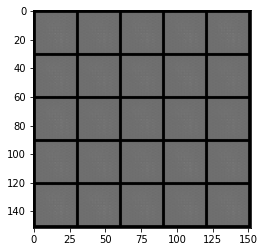

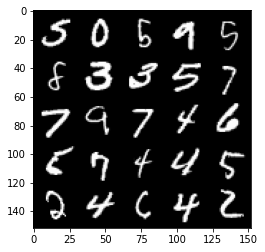

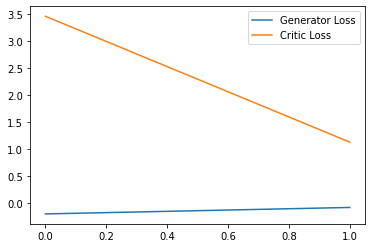

Step 100: Generator loss: 2.3032829493284224, critic loss: -4.376726088494062


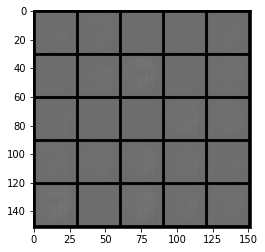

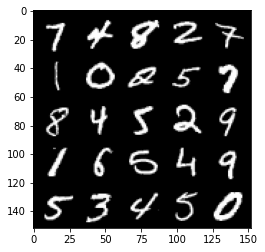

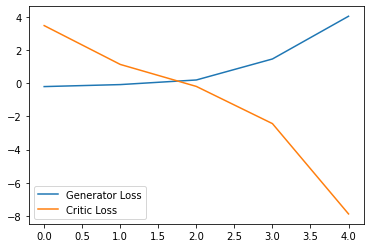

Step 150: Generator loss: 1.4975614683330059, critic loss: -13.120540796279911


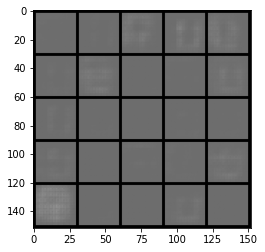

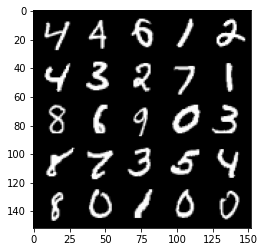

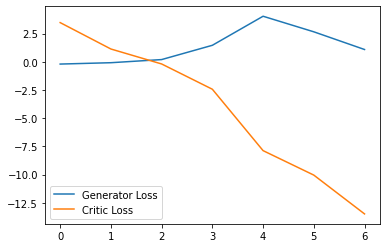

Step 200: Generator loss: 0.07069766789674758, critic loss: -32.95327938079834


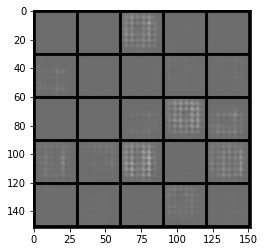

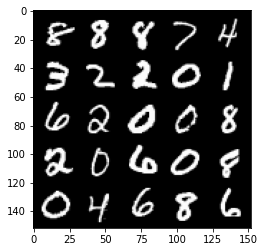

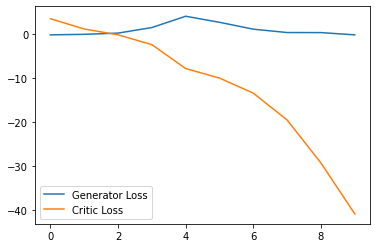

Step 250: Generator loss: 0.08537638299167156, critic loss: -67.19256935119628


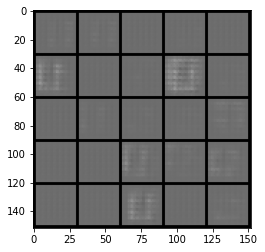

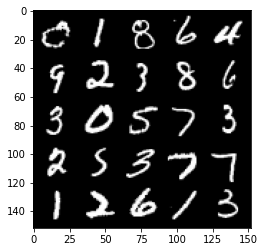

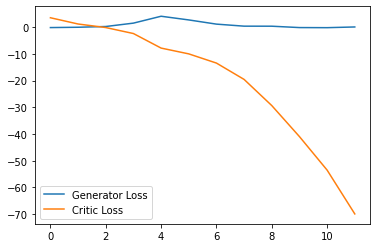

Step 300: Generator loss: 1.6854551112651825, critic loss: -112.857604888916


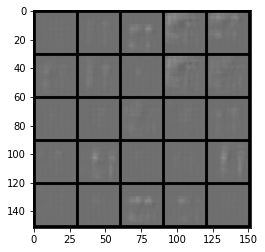

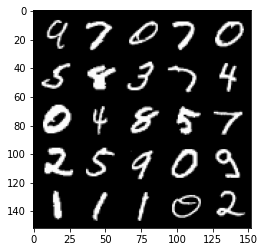

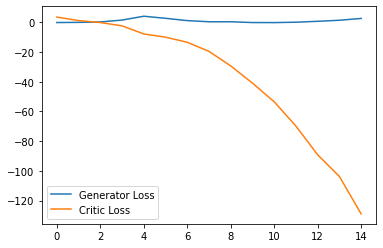

Step 350: Generator loss: 3.014439182281494, critic loss: -161.21348712158203


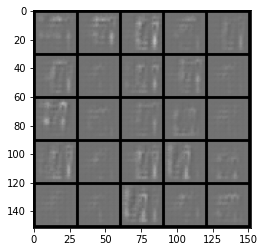

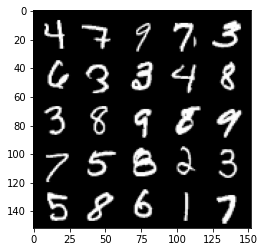

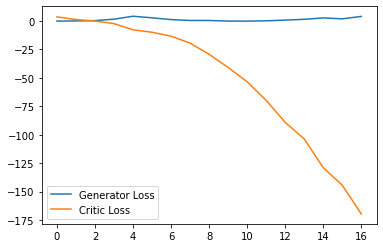

Step 400: Generator loss: 3.539014583826065, critic loss: -217.4200369262695


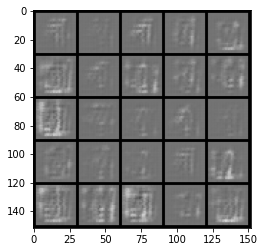

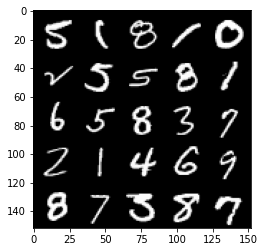

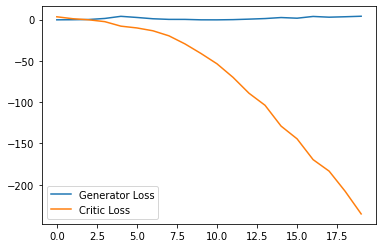

Step 450: Generator loss: -13.245084437727929, critic loss: -202.5537921905518


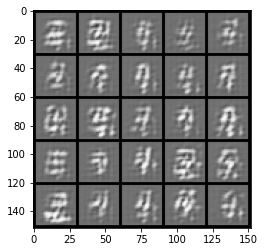

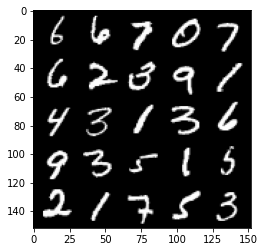

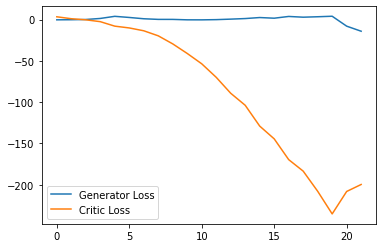

Step 500: Generator loss: 8.819110831022263, critic loss: -262.620556930542


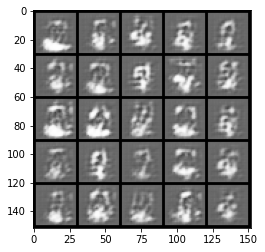

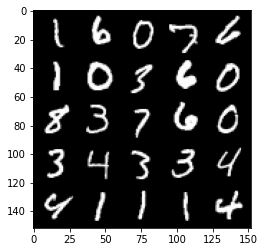

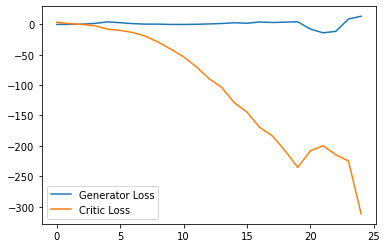

Step 550: Generator loss: 9.86677274107933, critic loss: -356.1496994018555


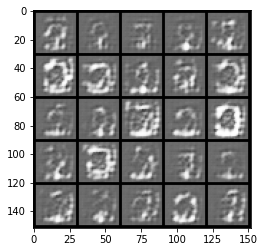

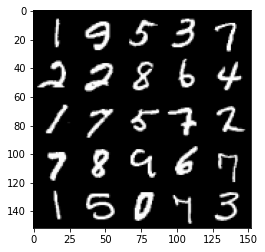

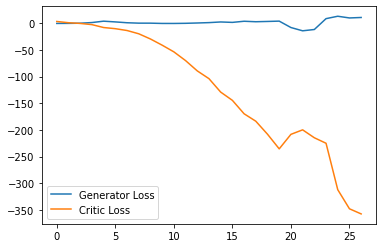

Step 600: Generator loss: -13.452890126705169, critic loss: -324.2337387084961


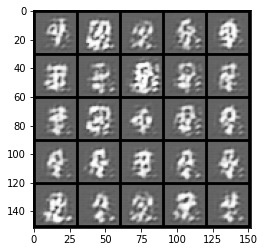

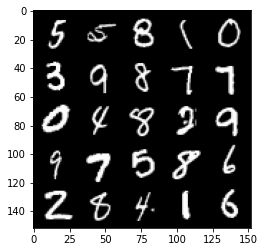

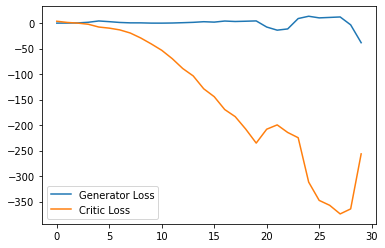

Step 650: Generator loss: 14.696223738193511, critic loss: -304.0425958251954


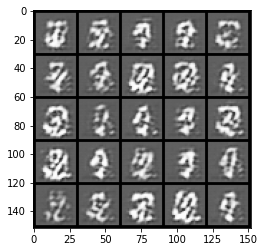

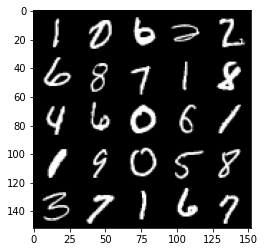

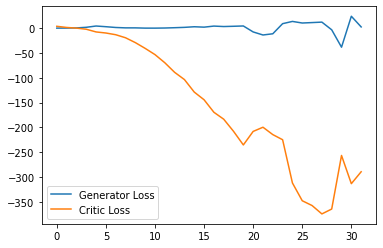

Step 700: Generator loss: 8.311429181694985, critic loss: -323.0875748291015


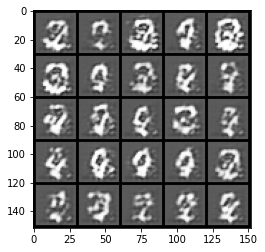

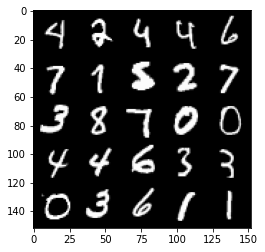

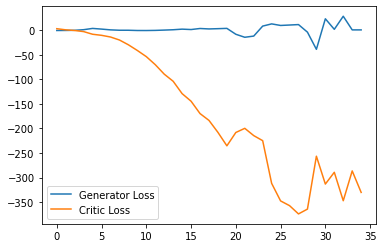

Step 750: Generator loss: -7.2874432939291, critic loss: -351.71316052246107


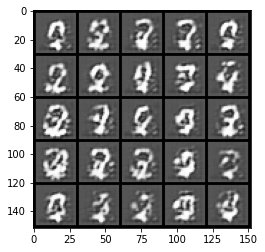

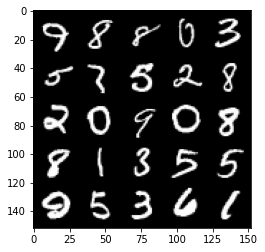

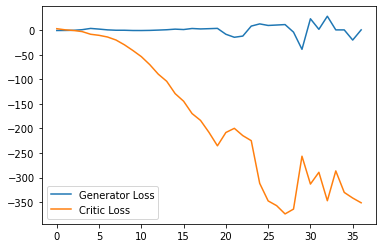

Step 800: Generator loss: -42.62460241317749, critic loss: -223.2086212234497


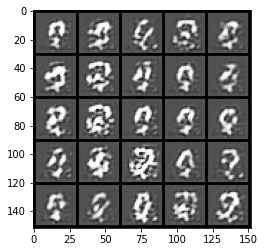

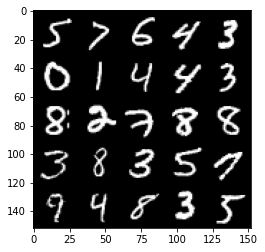

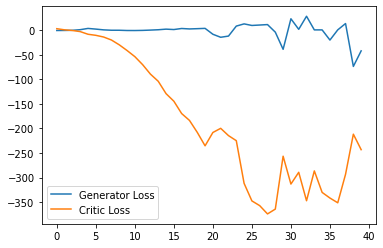

Step 850: Generator loss: -1.8771283960342406, critic loss: -150.99830779647831


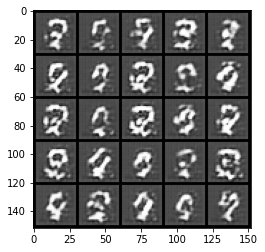

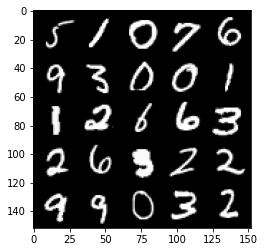

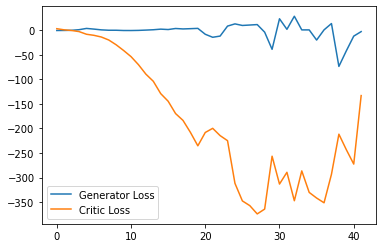

Step 900: Generator loss: 4.393165462613106, critic loss: 17.50597076797486


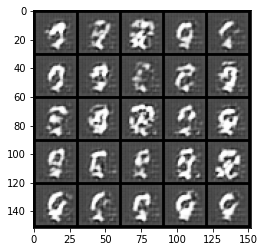

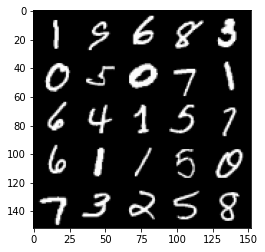

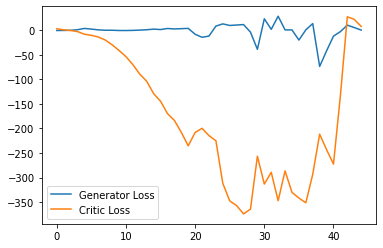

Step 950: Generator loss: -24.47129241466522, critic loss: -95.88217432403565


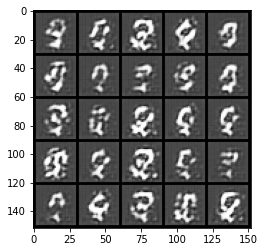

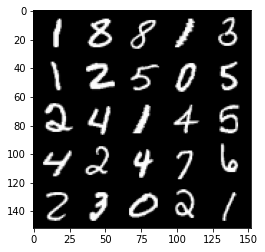

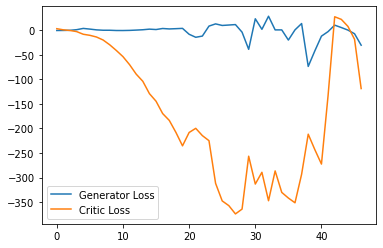

Step 1000: Generator loss: -63.82149291038513, critic loss: -165.69229046630863


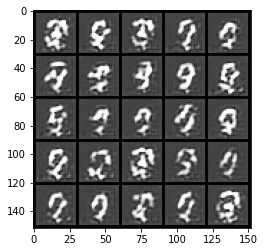

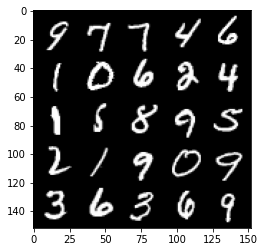

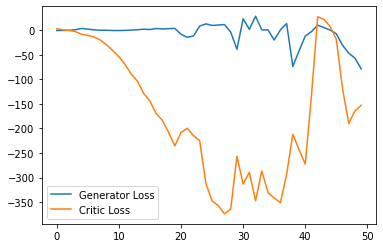

Step 1050: Generator loss: -77.93753405094147, critic loss: -176.38236091613769


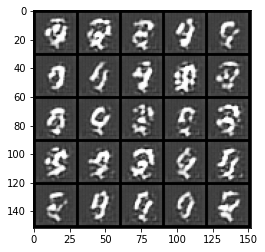

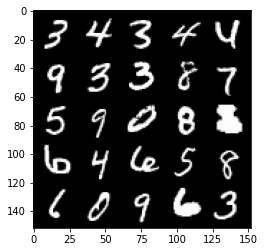

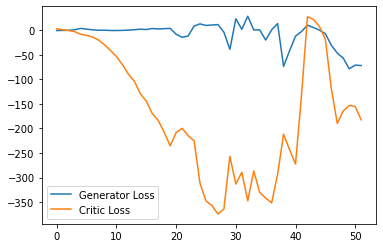

Step 1100: Generator loss: -61.77388091981411, critic loss: -187.25222839355465


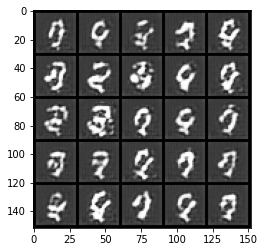

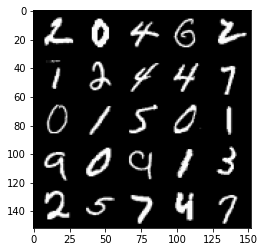

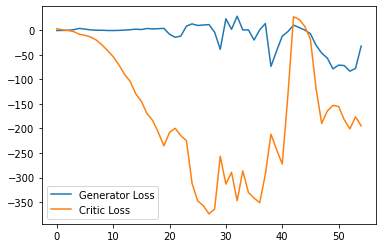

Step 1150: Generator loss: -17.105110940933226, critic loss: -136.6172418365478


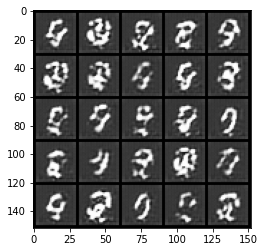

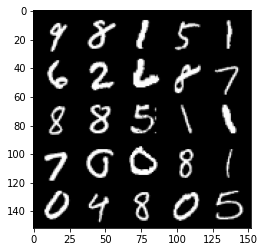

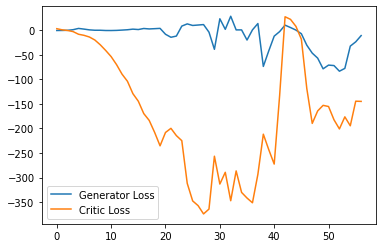

Step 1200: Generator loss: -20.32265415430069, critic loss: -111.71113493347167


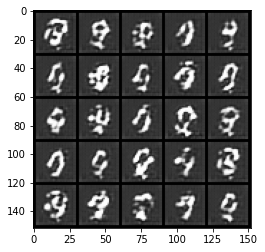

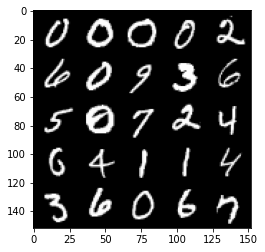

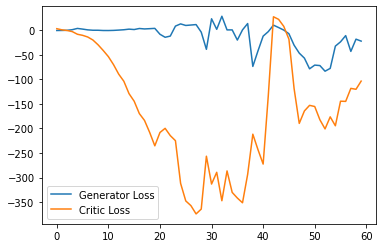

Step 1250: Generator loss: -34.209032419919964, critic loss: -109.99709234619142


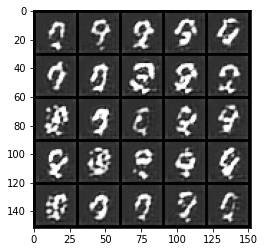

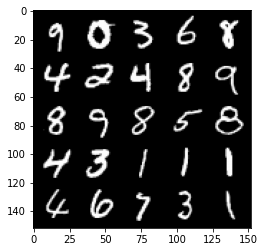

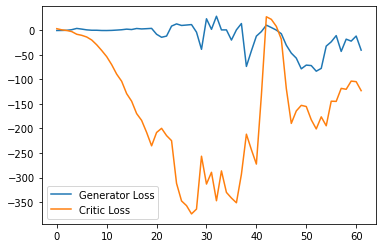

Step 1300: Generator loss: -31.971868159770967, critic loss: -77.3013879852295


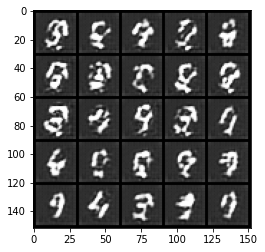

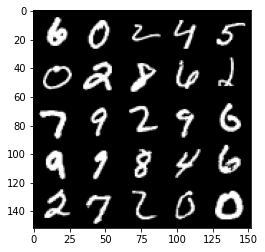

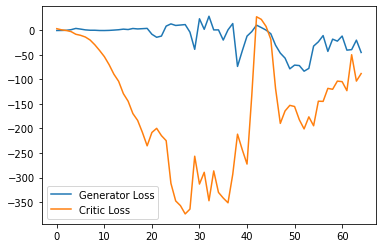

Step 1350: Generator loss: -31.398163976669313, critic loss: -70.82224377441406


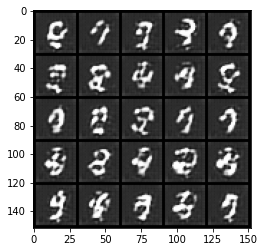

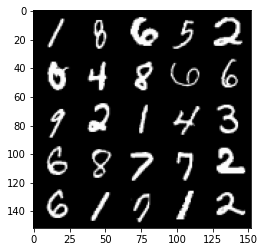

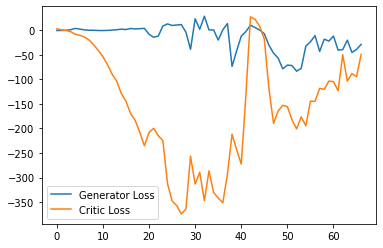

Step 1400: Generator loss: -34.64075578689575, critic loss: -80.52107405090332


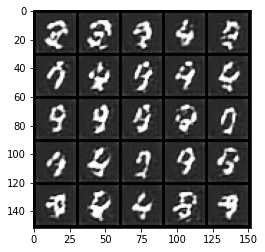

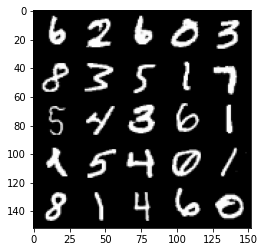

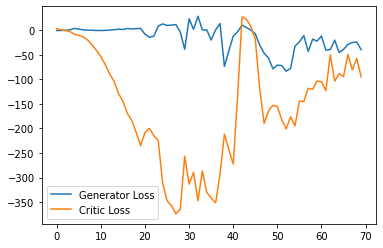

Step 1450: Generator loss: -0.8936539673805237, critic loss: -10.946416763305667


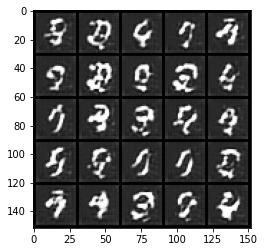

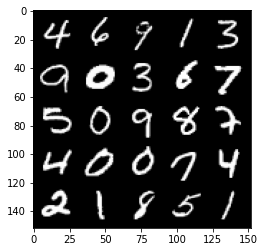

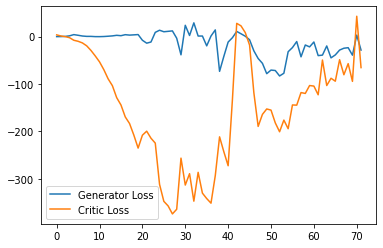

Step 1500: Generator loss: -32.563100004196166, critic loss: -71.49513360595702


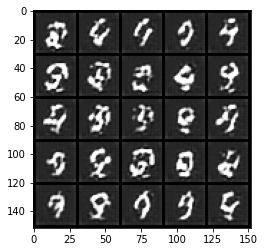

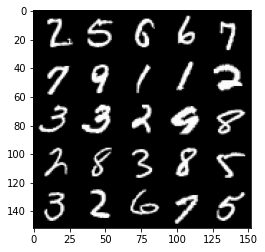

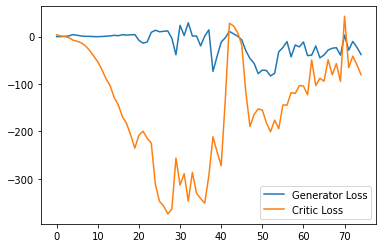

Step 1550: Generator loss: 17.527493400573732, critic loss: 13.038028419494621


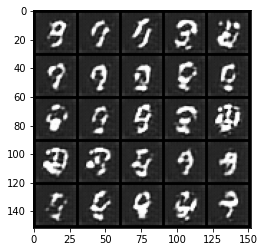

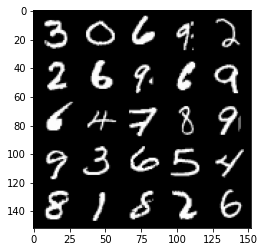

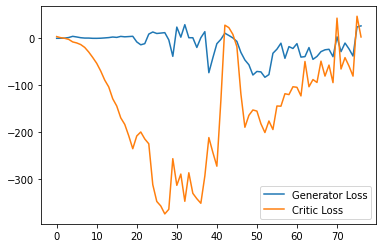

Step 1600: Generator loss: 6.335250806808472, critic loss: -8.296307281494132


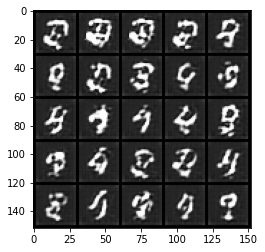

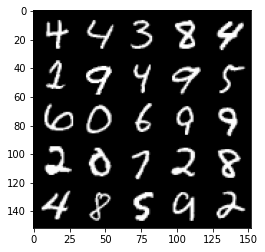

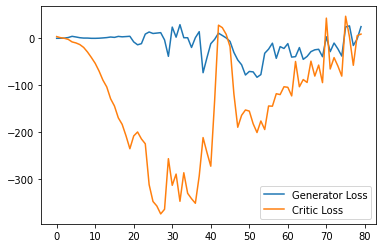

Step 1650: Generator loss: -2.896685838699341, critic loss: -16.272989017486573


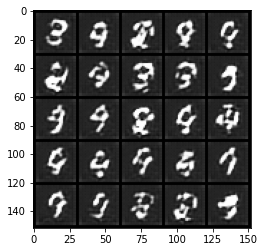

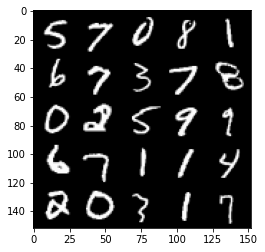

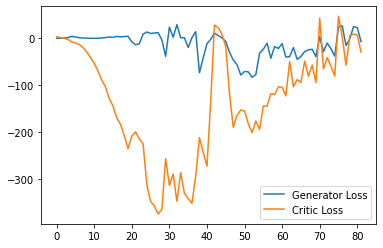

Step 1700: Generator loss: -7.6345218825340275, critic loss: -32.452935344696044


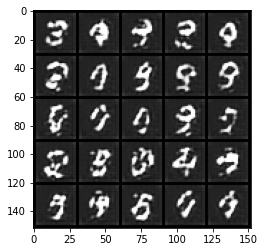

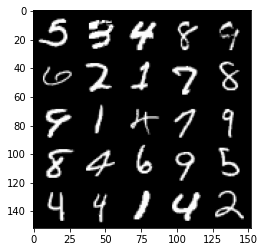

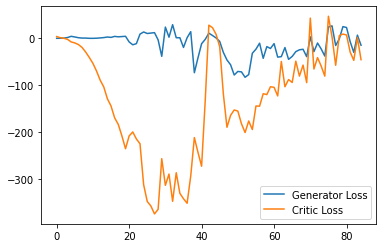

Step 1750: Generator loss: 16.31902332305908, critic loss: 24.013858798980706


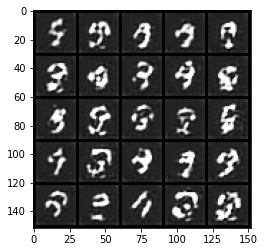

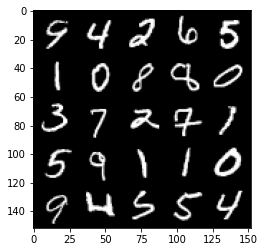

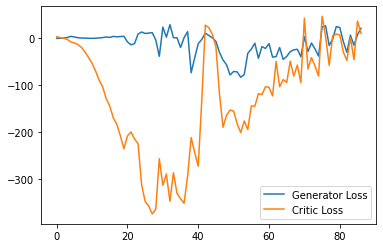

Step 1800: Generator loss: 14.75952507019043, critic loss: 10.733034027099611


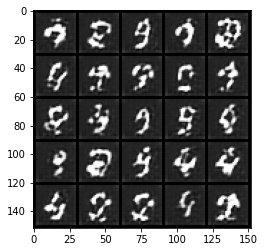

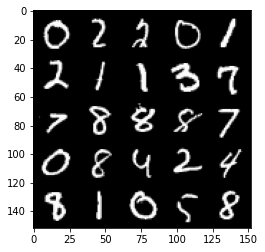

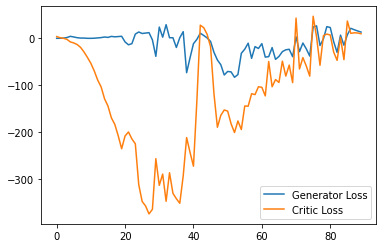

Step 1850: Generator loss: 10.956068181991578, critic loss: 5.220820983886719


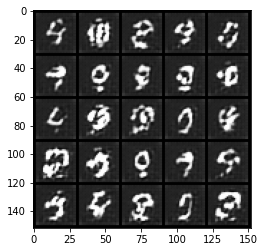

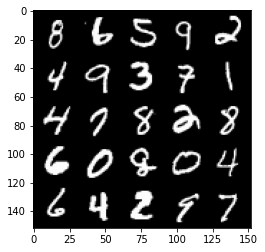

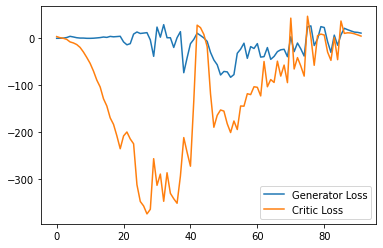

Step 1900: Generator loss: -1.072033194899559, critic loss: -1.6578846855163574


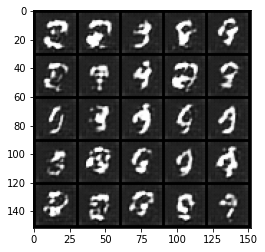

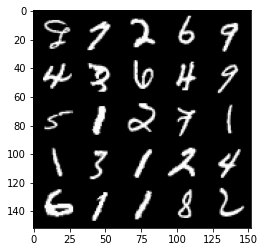

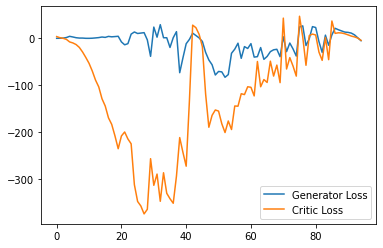

Step 1950: Generator loss: -18.83004201889038, critic loss: -10.751889507293697


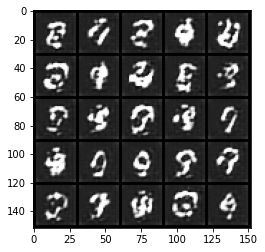

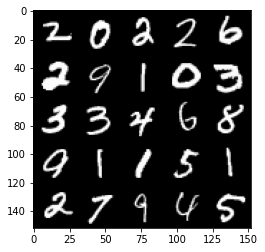

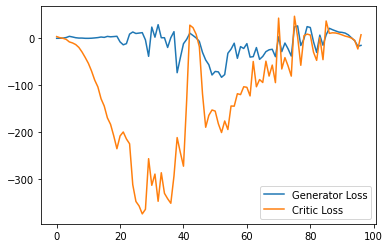

Step 2000: Generator loss: 4.855879745483398, critic loss: 64.58016994094847


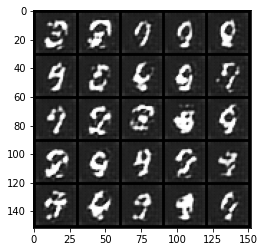

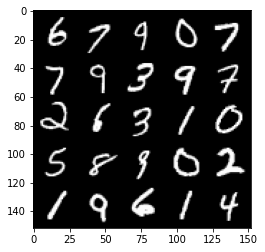

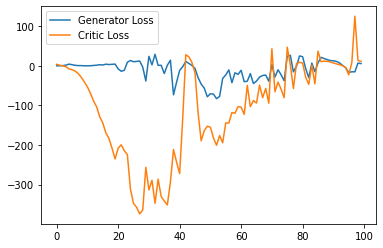

Step 2050: Generator loss: 4.809993057250977, critic loss: 9.967287605285645


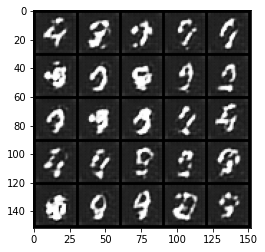

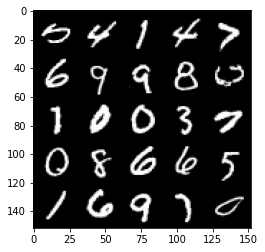

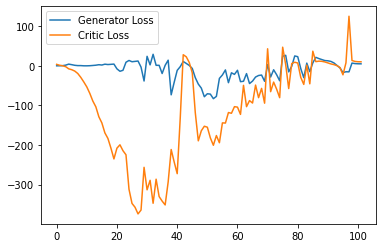

Step 2100: Generator loss: 4.67519471168518, critic loss: 9.876048801422119


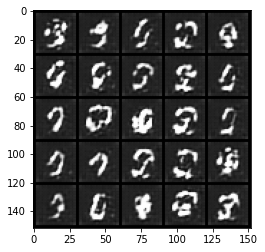

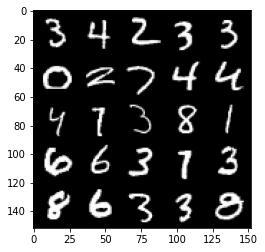

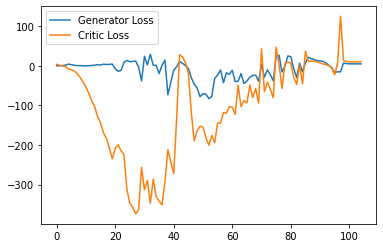

Step 2150: Generator loss: 4.6829421329498295, critic loss: 9.057190216064452


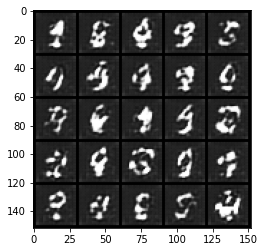

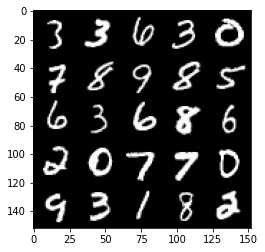

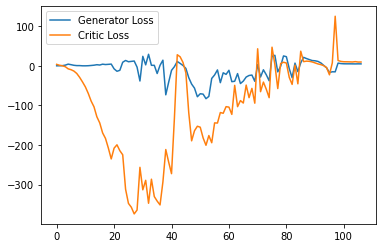

Step 2200: Generator loss: 4.807310218811035, critic loss: 7.517838955879212


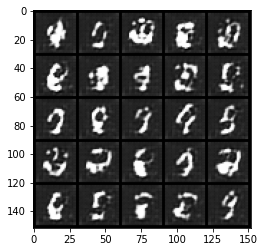

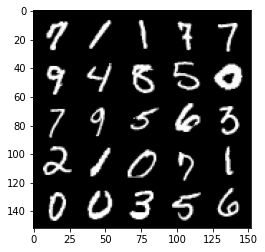

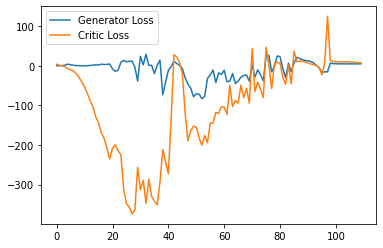

Step 2250: Generator loss: 5.448966808319092, critic loss: 5.995102331161499


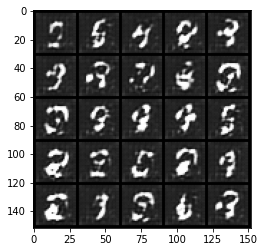

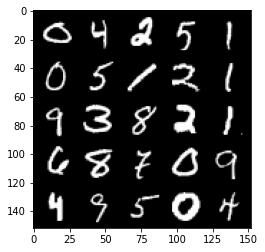

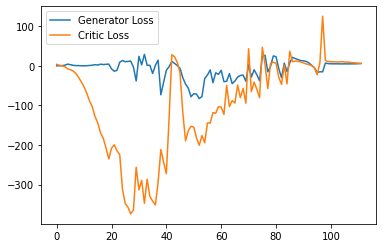

Step 2300: Generator loss: 6.494918937683106, critic loss: 4.401573631286621


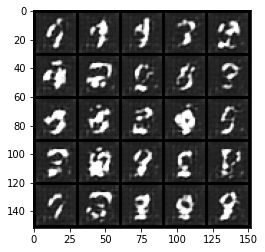

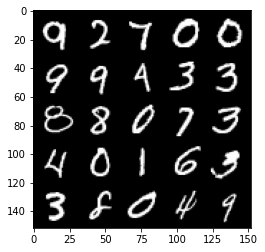

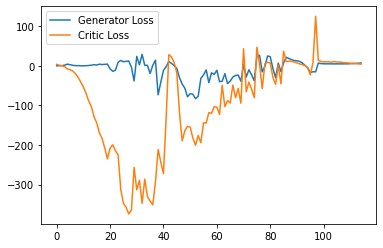

Step 2350: Generator loss: 7.4294788265228275, critic loss: 3.6041593275070203


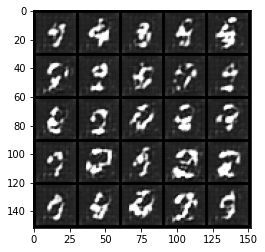

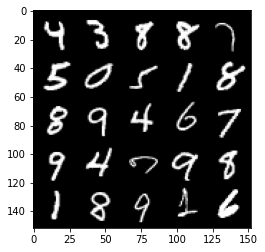

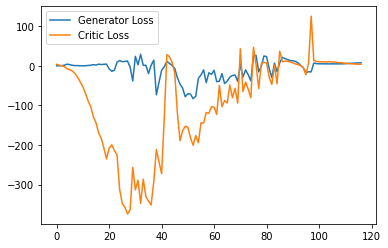

Step 2400: Generator loss: 7.843592138290405, critic loss: 2.667699686050414


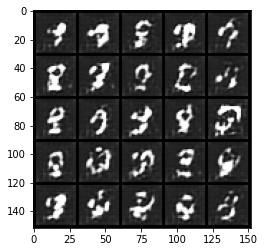

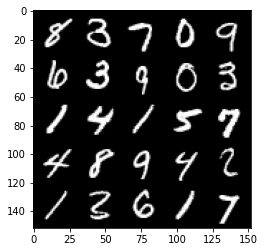

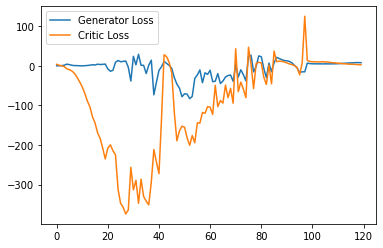

Step 2450: Generator loss: 7.38758900642395, critic loss: 2.1600227556228644


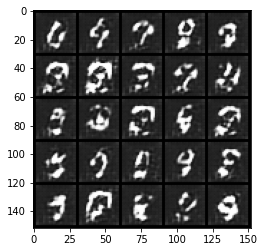

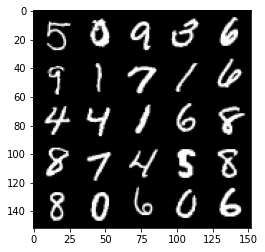

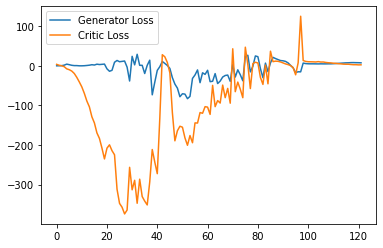

Step 2500: Generator loss: 6.54301236152649, critic loss: 1.915373196601867


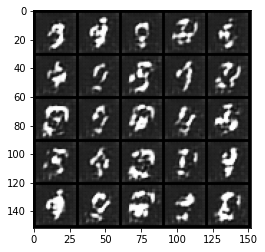

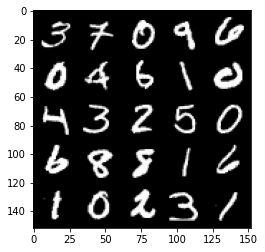

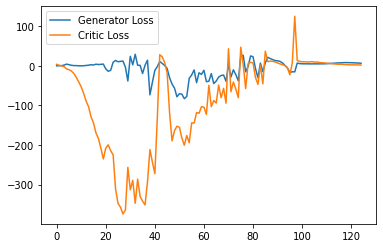

Step 2550: Generator loss: 4.738045725822449, critic loss: 1.1130135850906375


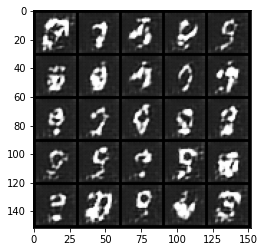

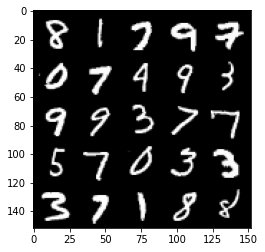

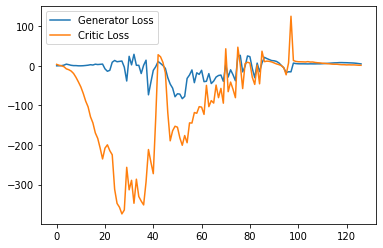

Step 2600: Generator loss: 2.5868542647361754, critic loss: 0.053221652507781984


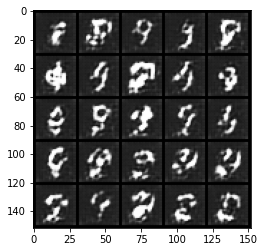

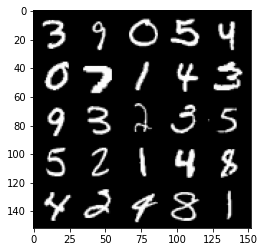

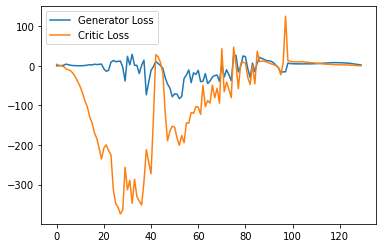

Step 2650: Generator loss: 0.18922029361128806, critic loss: -1.0123369030952454


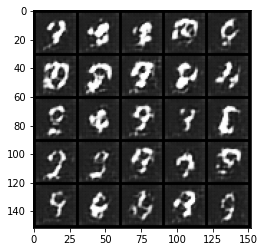

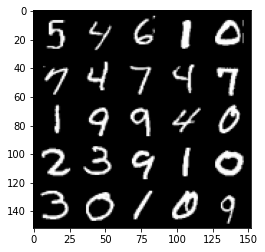

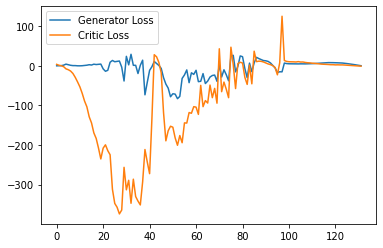

Step 2700: Generator loss: -2.2386744356155397, critic loss: -1.706147488117218


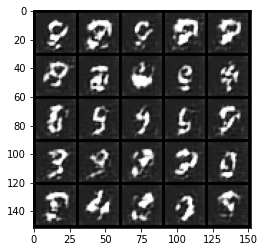

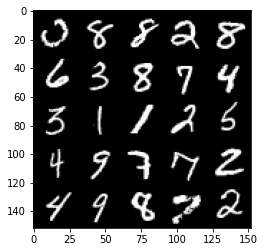

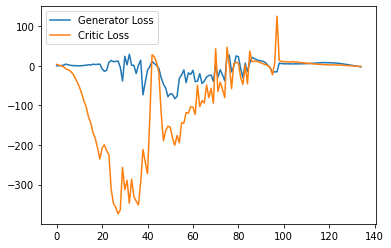

Step 2750: Generator loss: -4.1038054180145265, critic loss: -2.120571578025818


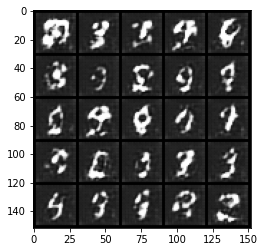

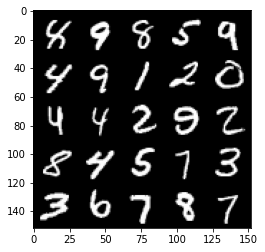

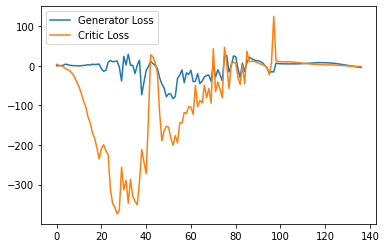

Step 2800: Generator loss: -5.007965383529663, critic loss: -2.4642335534095765


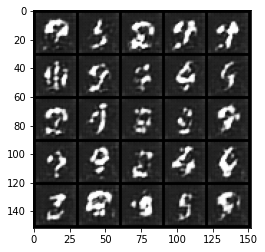

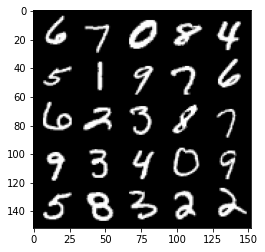

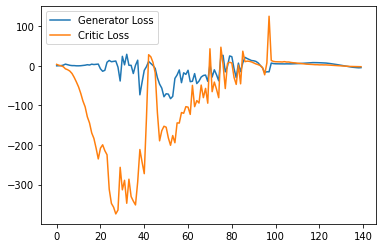

Step 2850: Generator loss: -4.741378197669983, critic loss: -2.5185869398117062


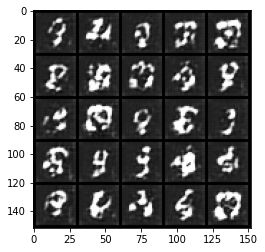

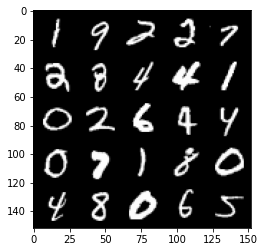

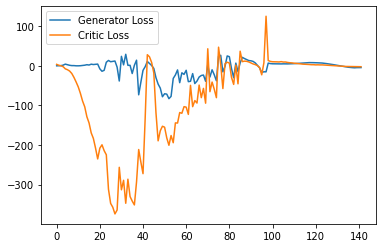

Step 2900: Generator loss: -4.811478090286255, critic loss: -2.613522265434266


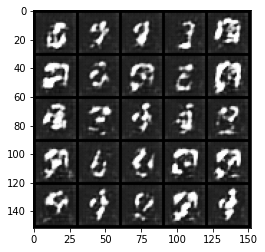

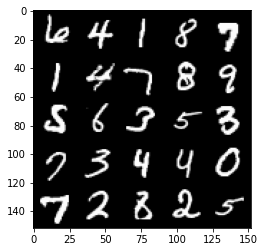

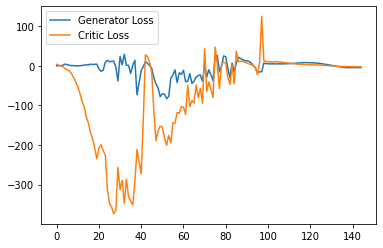

Step 2950: Generator loss: -4.566370134353638, critic loss: -3.127579171180725


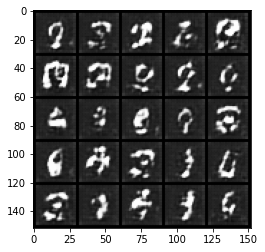

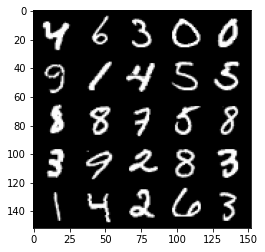

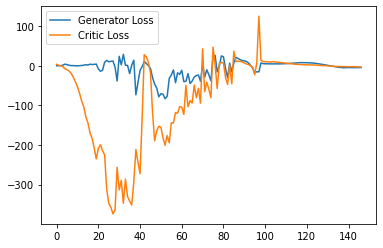

Step 3000: Generator loss: -4.909763431549072, critic loss: -3.9328075752258305


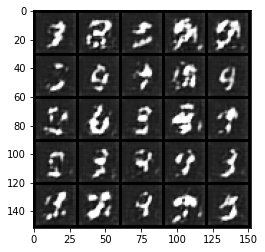

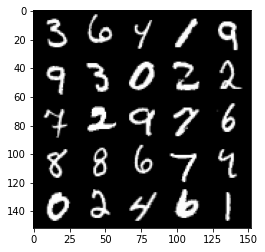

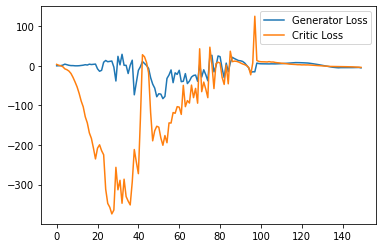

Step 3050: Generator loss: -6.899019565582275, critic loss: -5.26135099697113


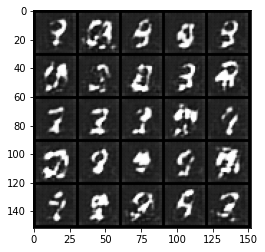

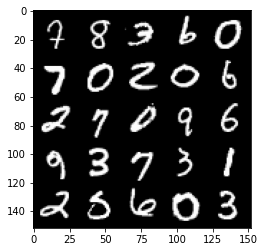

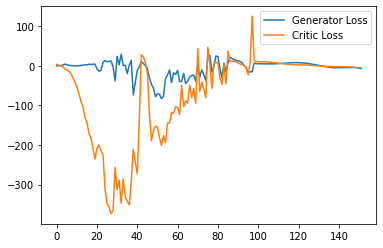

Step 3100: Generator loss: -7.760363941192627, critic loss: -6.407955745697021


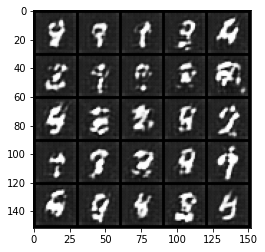

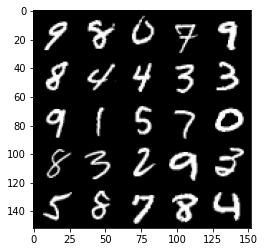

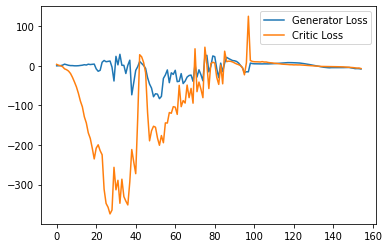

Step 3150: Generator loss: -8.923058090209961, critic loss: -8.909482791900635


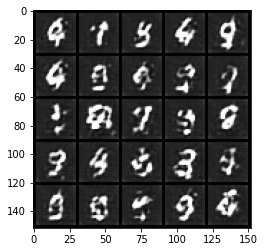

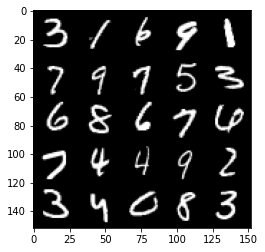

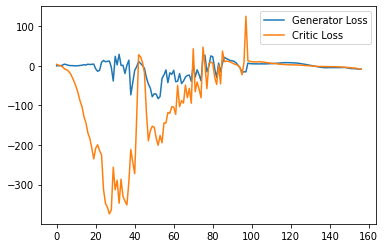

Step 3200: Generator loss: -10.371186332702637, critic loss: -10.73332886505127


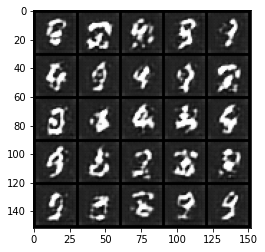

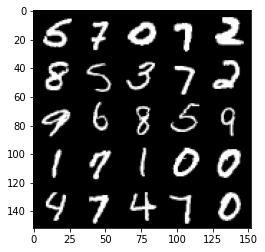

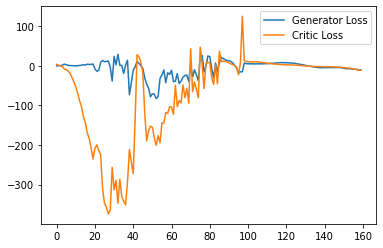

Step 3250: Generator loss: -11.336725234985352, critic loss: -12.484666547775271


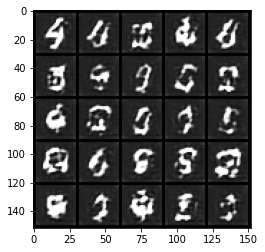

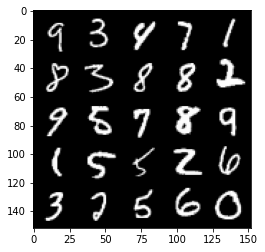

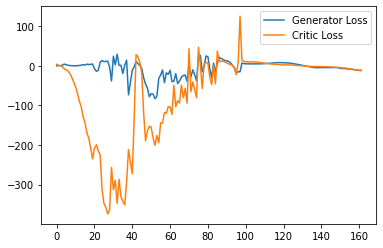

Step 3300: Generator loss: -12.926970310211182, critic loss: -14.717180671691894


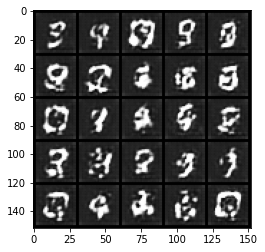

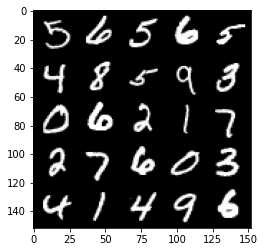

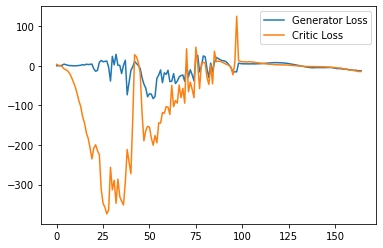

Step 3350: Generator loss: -12.717660139799118, critic loss: -16.79164320373535


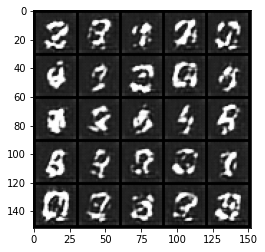

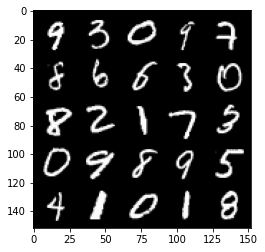

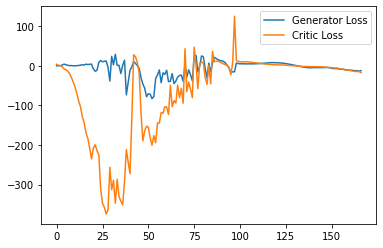

Step 3400: Generator loss: -11.318353509902954, critic loss: -19.20935266494751


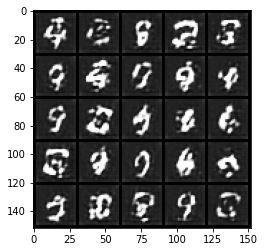

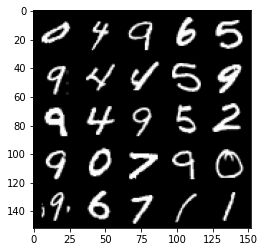

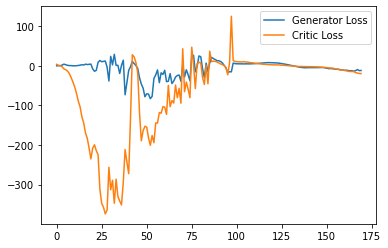

Step 3450: Generator loss: -10.052300069332123, critic loss: -16.35145984268188


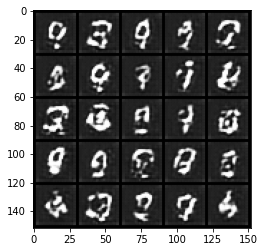

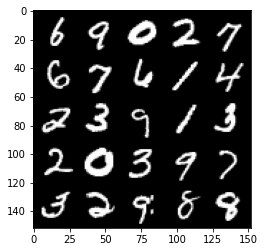

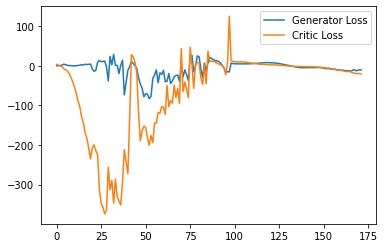

Step 3500: Generator loss: -6.242104959487915, critic loss: -0.7723440117835998


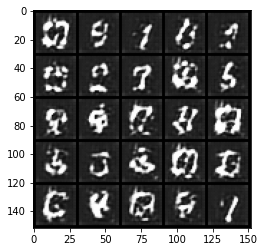

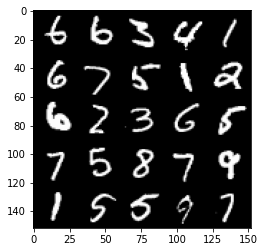

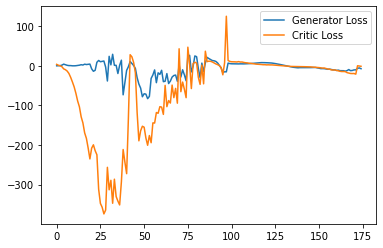

Step 3550: Generator loss: -13.398791999816895, critic loss: -4.140491978645324


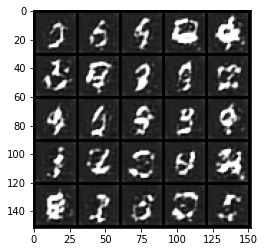

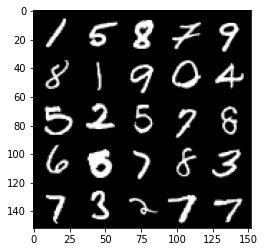

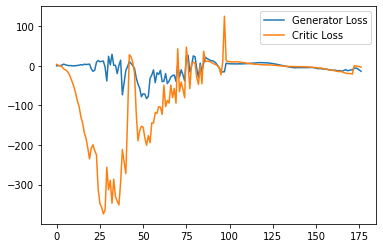

Step 3600: Generator loss: -19.59767593383789, critic loss: -19.480967414855954


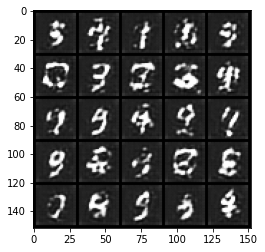

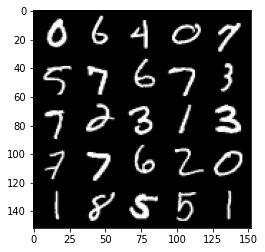

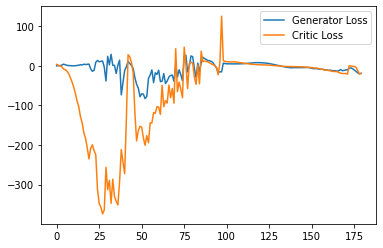

Step 3650: Generator loss: -17.170113735198974, critic loss: -21.785506700515743


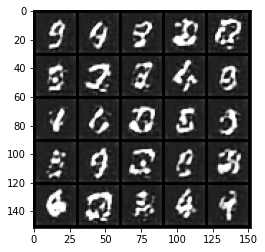

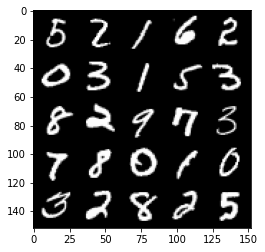

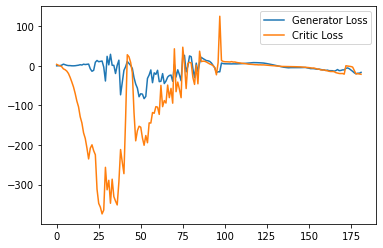

Step 3700: Generator loss: -14.912821984291076, critic loss: -20.461365892410278


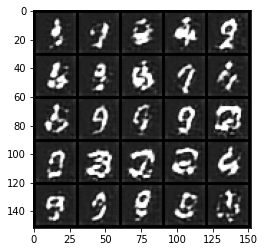

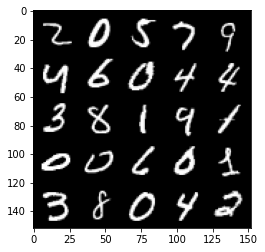

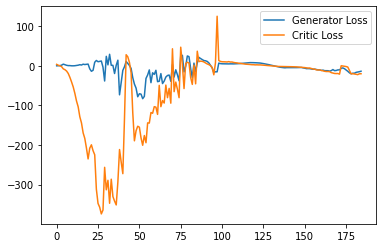

Step 3750: Generator loss: -14.357477698326111, critic loss: -22.954749385833733


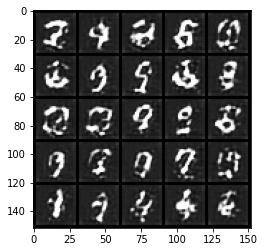

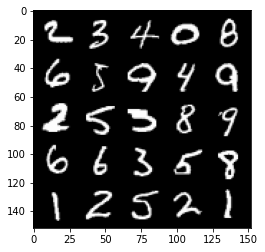

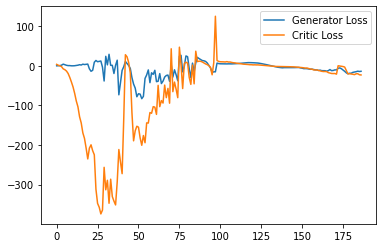

Step 3800: Generator loss: -13.482328672409057, critic loss: -22.424983045578006


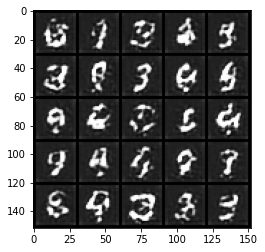

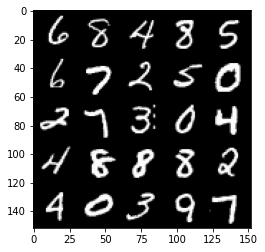

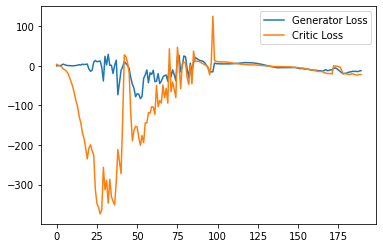

Step 3850: Generator loss: -11.556341467797756, critic loss: -23.89897481918335


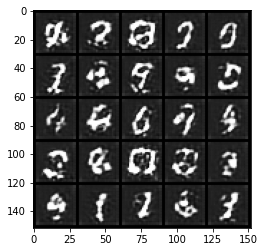

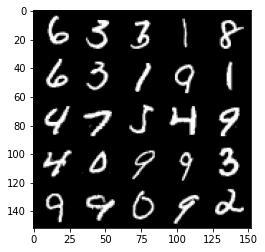

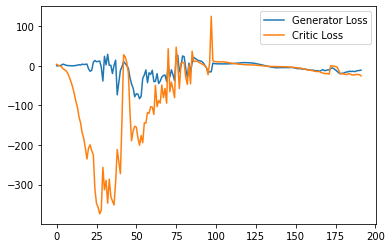

Step 3900: Generator loss: -11.14278598755598, critic loss: -24.29582892417908


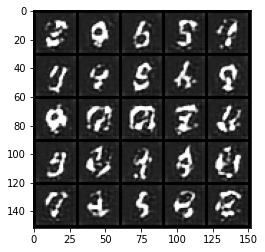

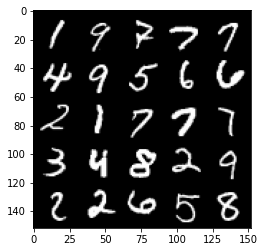

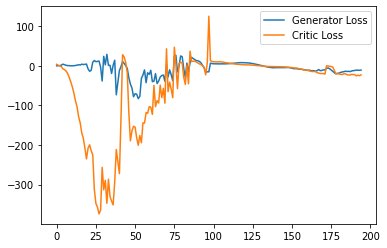

Step 3950: Generator loss: -10.866415227800609, critic loss: -24.875187660217286


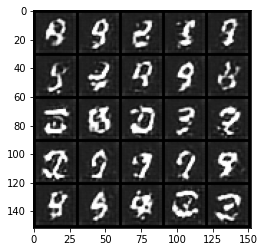

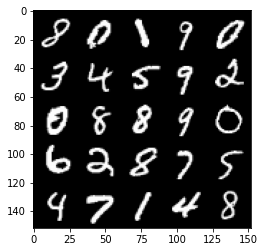

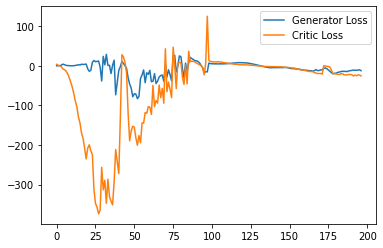

Step 4000: Generator loss: -5.479873595833778, critic loss: -9.093022778034213


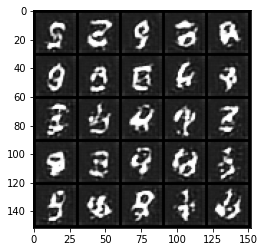

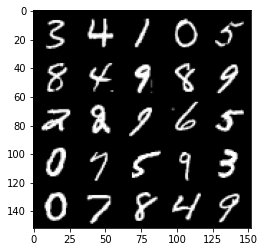

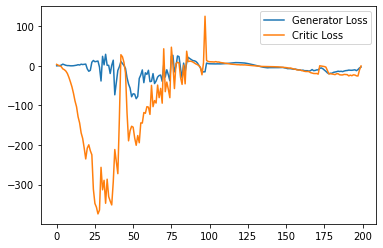

Step 4050: Generator loss: -4.578223147392273, critic loss: -1.3666192011833191


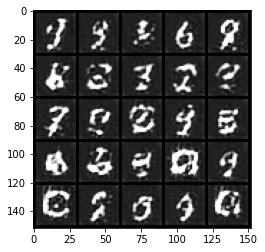

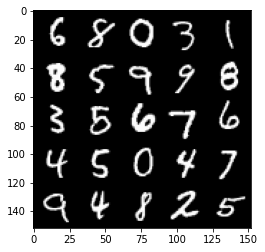

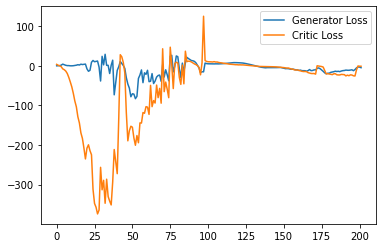

Step 4100: Generator loss: -8.057633419036865, critic loss: -1.9397293267250064


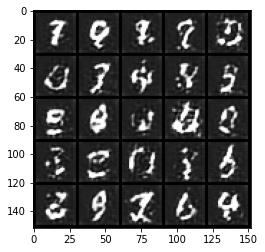

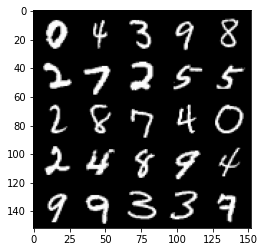

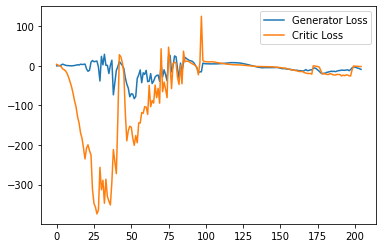

Step 4150: Generator loss: -10.964271850585938, critic loss: -2.8158667078018182


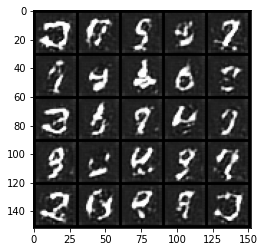

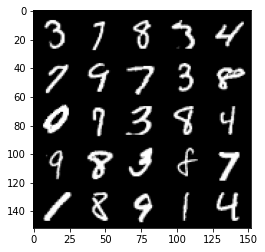

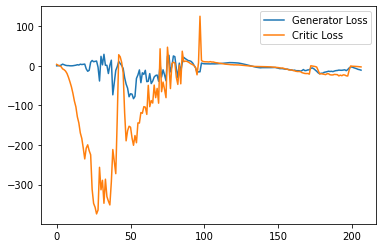

Step 4200: Generator loss: -16.533015270233154, critic loss: -9.147793580055238


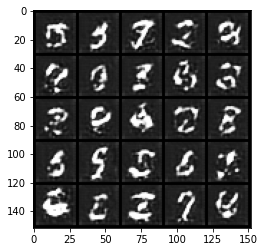

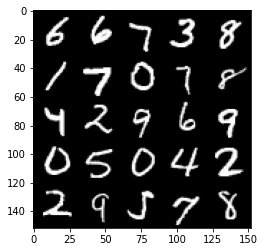

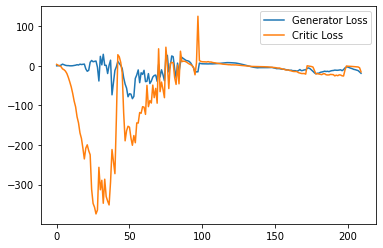

Step 4250: Generator loss: -15.825885636806488, critic loss: -18.226176481246945


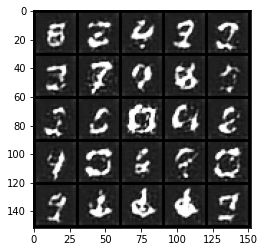

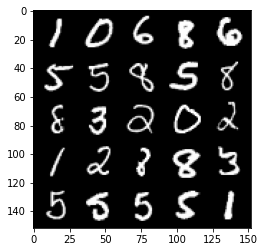

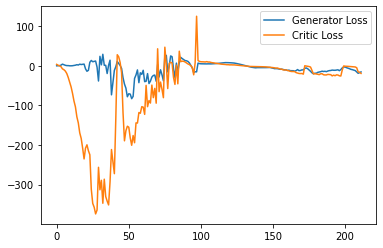

Step 4300: Generator loss: -13.588362984657287, critic loss: -20.600700174331664


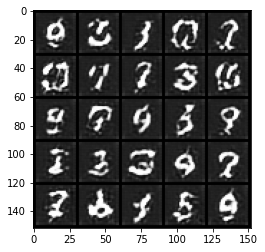

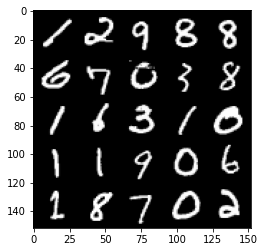

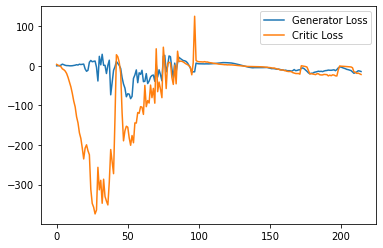

Step 4350: Generator loss: -10.888132939338684, critic loss: -14.694793593406676


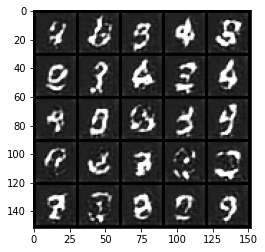

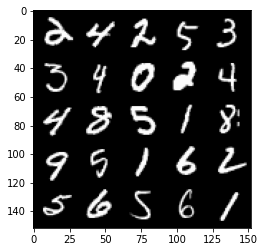

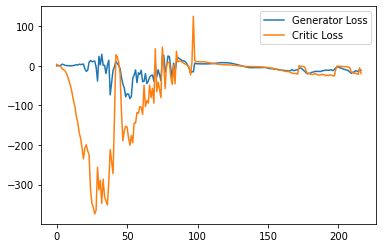

Step 4400: Generator loss: -11.674946036338806, critic loss: -22.058918131828314


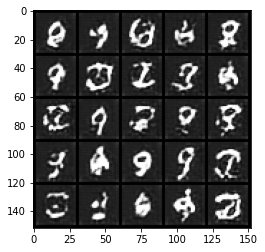

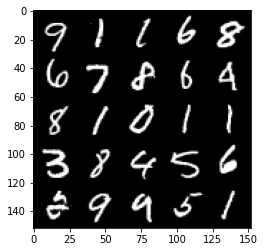

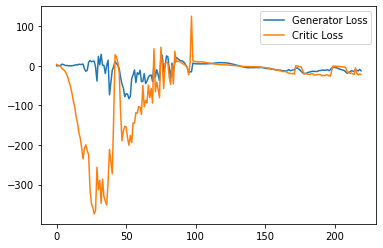

Step 4450: Generator loss: -9.96861575603485, critic loss: -20.322875328063972


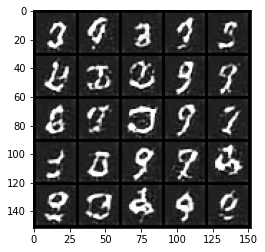

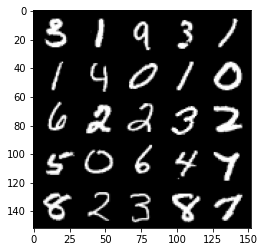

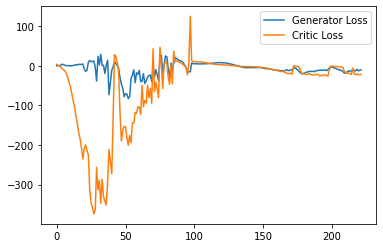

Step 4500: Generator loss: -11.857368848323823, critic loss: -21.594594621658324


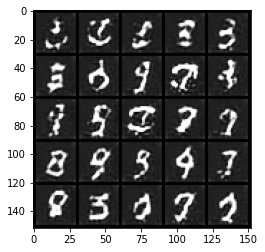

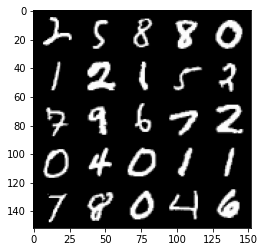

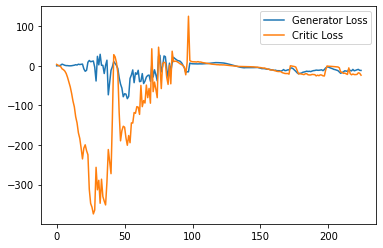

Step 4550: Generator loss: -11.403120147287845, critic loss: -19.907003382682795


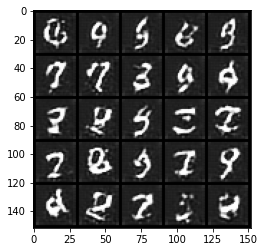

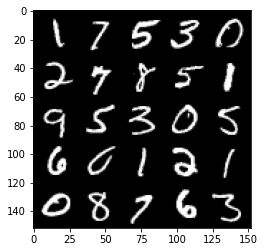

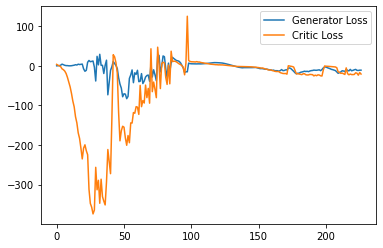

Step 4600: Generator loss: -12.437746258378029, critic loss: -21.3049452457428


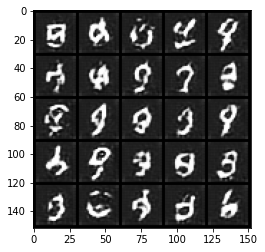

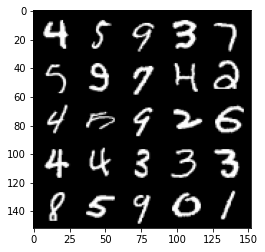

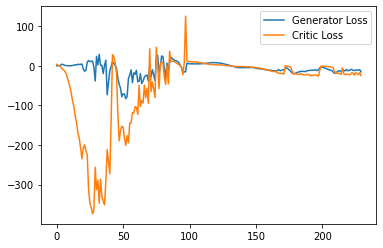

Step 4650: Generator loss: -14.075019583702087, critic loss: -23.509266635894775


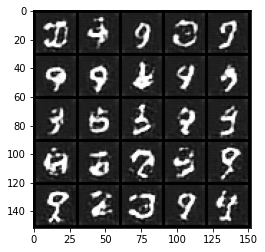

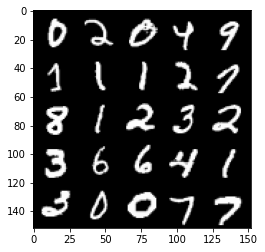

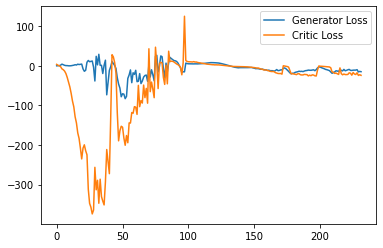

Step 4700: Generator loss: -6.673102011680603, critic loss: -3.4119650940895085


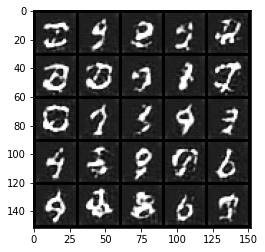

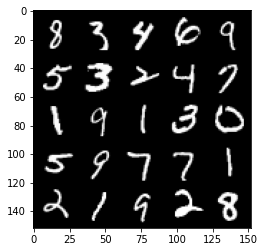

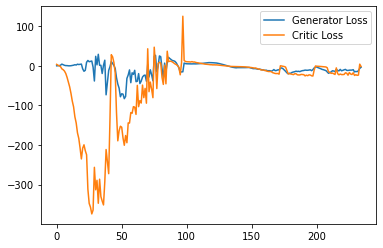

Step 4750: Generator loss: -5.370777883529663, critic loss: -1.9015015764236447


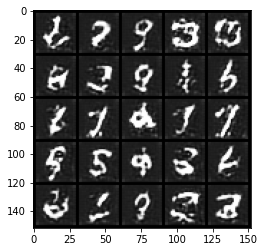

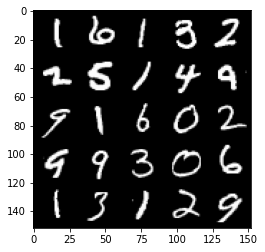

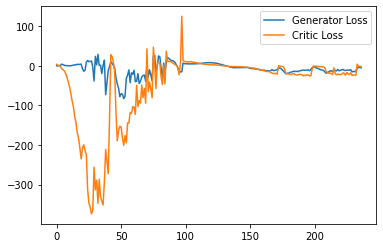

Step 4800: Generator loss: -9.993333435058593, critic loss: -3.6818566789627085


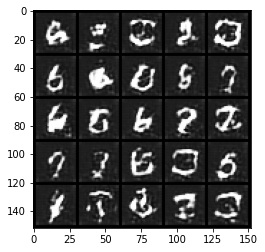

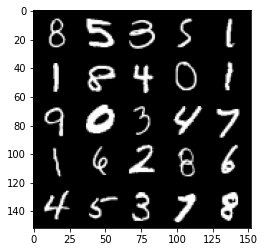

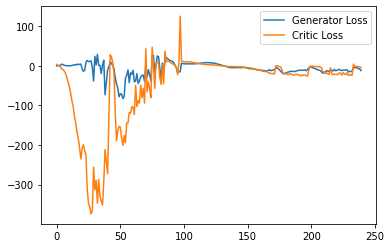

Step 4850: Generator loss: -15.804747703075408, critic loss: -19.685390421867368


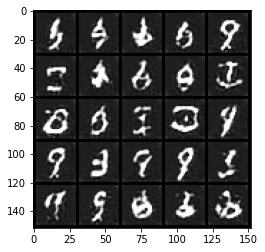

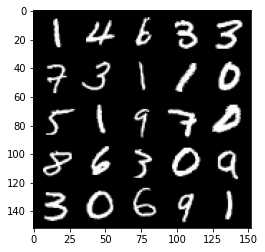

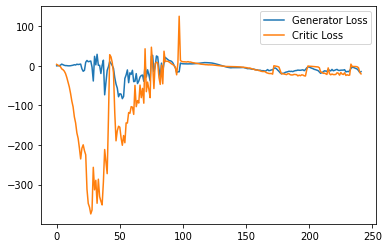

Step 4900: Generator loss: -7.145472555160523, critic loss: -0.8414872670173648


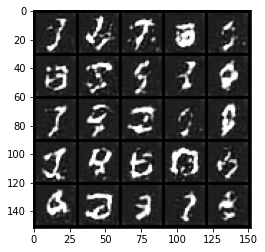

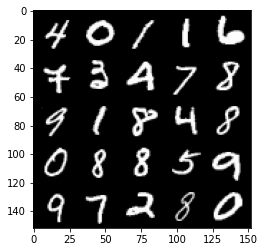

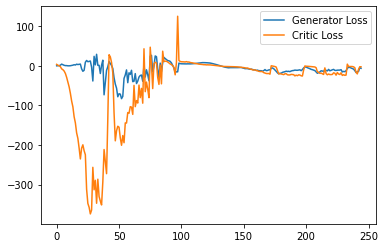

Step 4950: Generator loss: -15.181731026172638, critic loss: -15.74752422809601


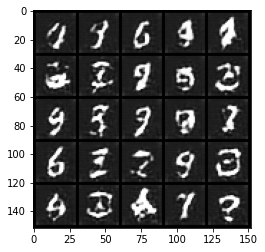

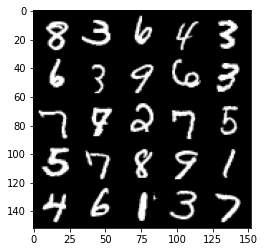

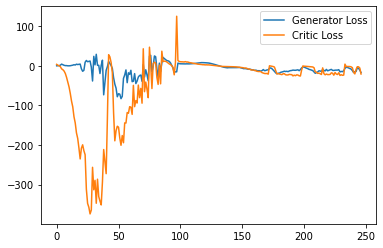

Step 5000: Generator loss: -16.062937912940978, critic loss: -21.67853125190735


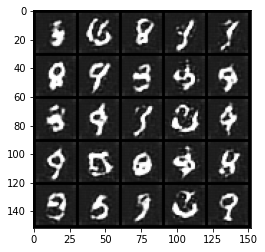

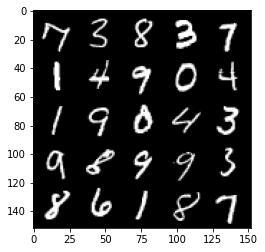

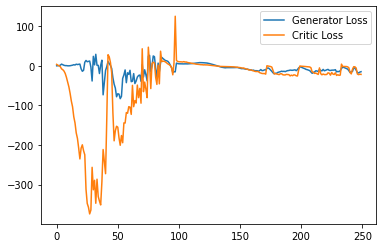

Step 5050: Generator loss: -11.048997800946236, critic loss: -19.126630674362175


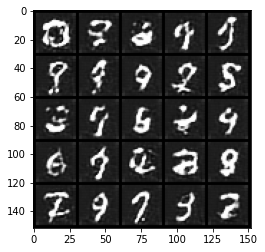

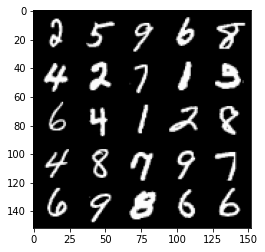

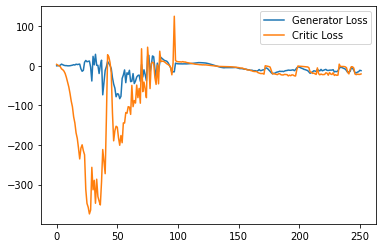

Step 5100: Generator loss: -12.781470329761506, critic loss: -18.47192974090576


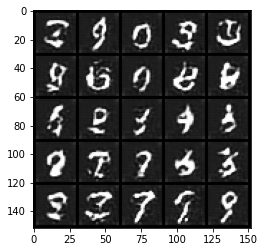

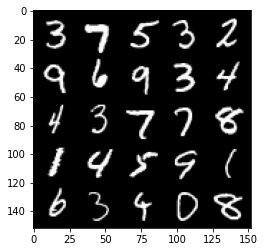

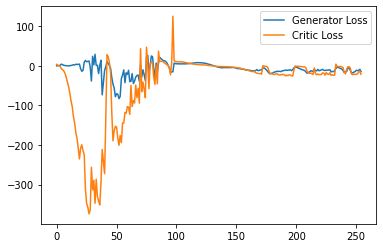

Step 5150: Generator loss: -12.754133584499359, critic loss: -21.914915985107424


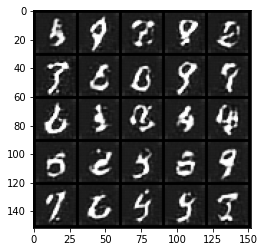

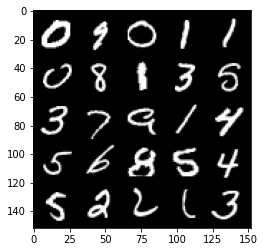

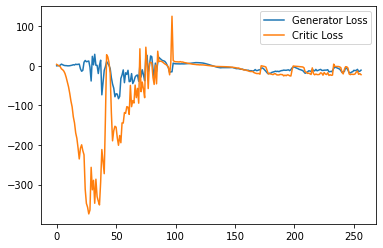

Step 5200: Generator loss: -13.0932744961977, critic loss: -20.772587538719176


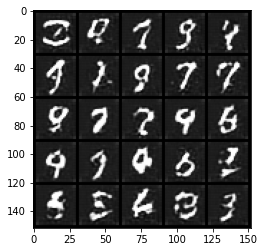

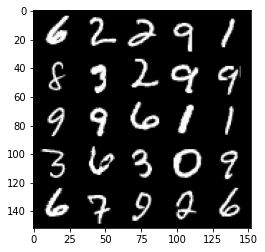

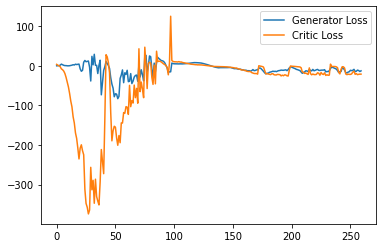

Step 5250: Generator loss: -12.217023956477641, critic loss: -21.068363188743596


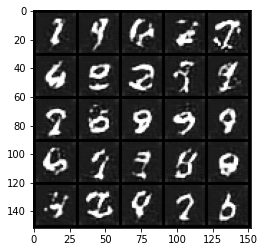

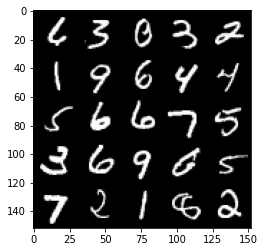

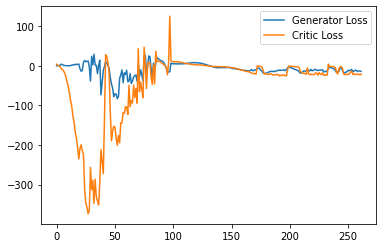

Step 5300: Generator loss: -10.009464557170867, critic loss: -12.023235242843628


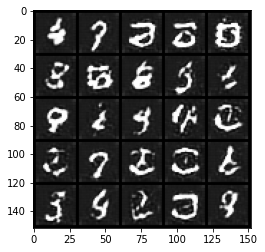

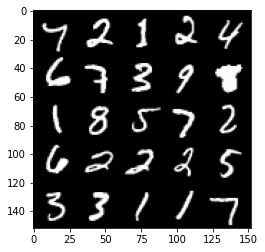

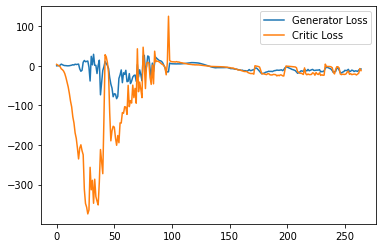

Step 5350: Generator loss: -13.848305535316467, critic loss: -20.735199459075925


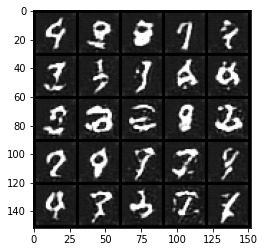

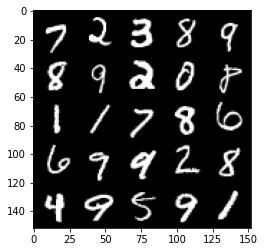

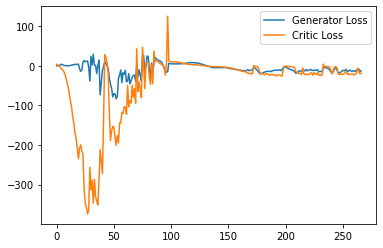

Step 5400: Generator loss: -12.216348476409912, critic loss: -19.423501576423643


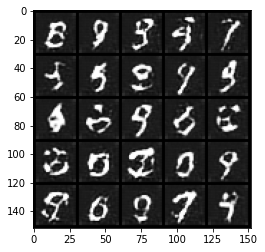

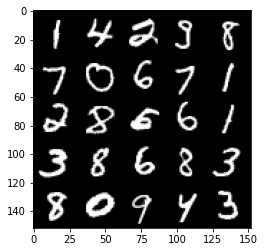

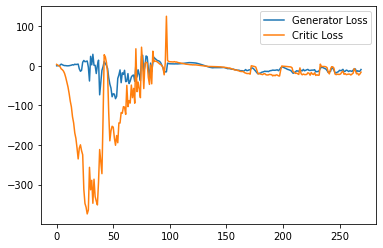

Step 5450: Generator loss: -12.454626459479332, critic loss: -20.08433529663086


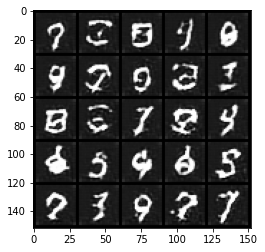

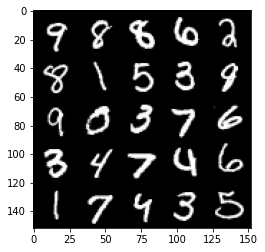

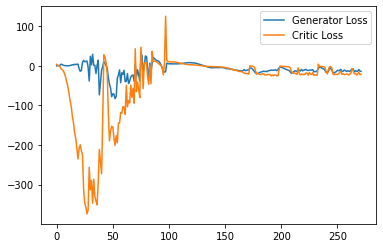

Step 5500: Generator loss: -16.615819416046143, critic loss: -21.290347551345832


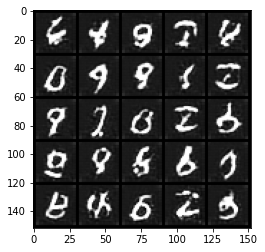

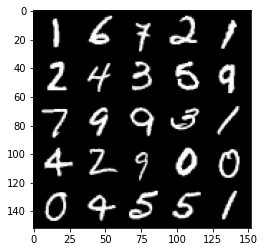

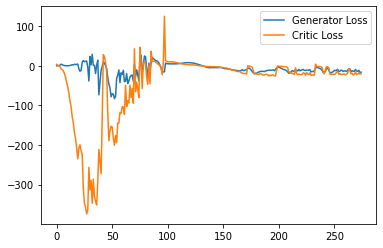

Step 5550: Generator loss: -11.642789041996002, critic loss: -13.10283567619324


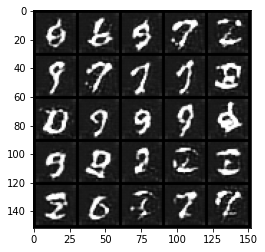

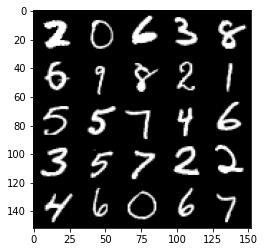

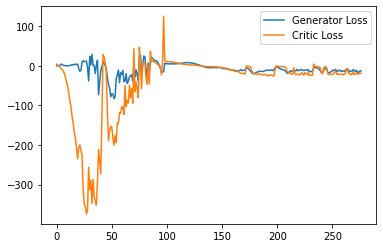

Step 5600: Generator loss: -14.820851182937622, critic loss: -17.594411258697505


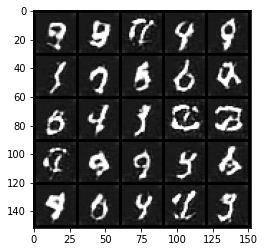

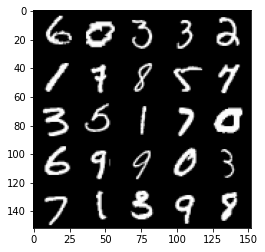

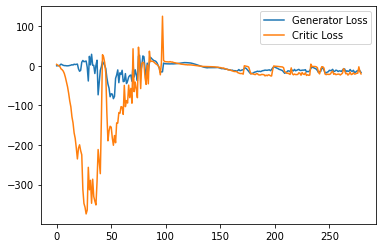

Step 5650: Generator loss: -13.568920392990112, critic loss: -18.49039657497406


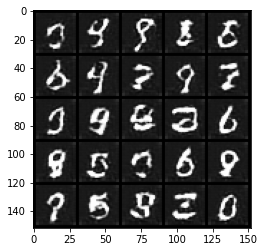

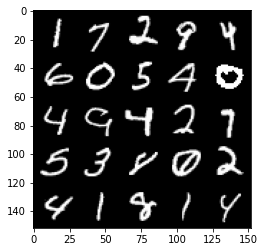

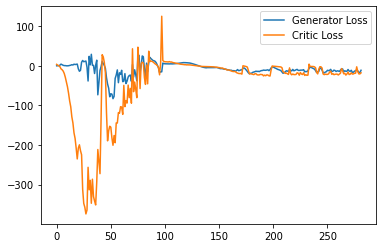

Step 5700: Generator loss: -16.97569670677185, critic loss: -17.20227564620972


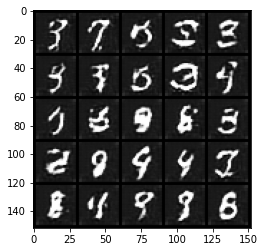

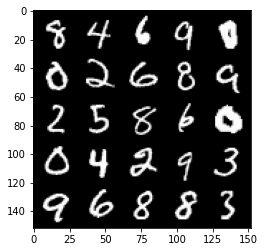

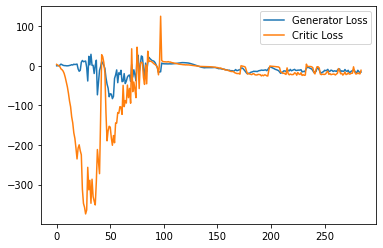

Step 5750: Generator loss: -8.247029362916946, critic loss: -11.291484044075014


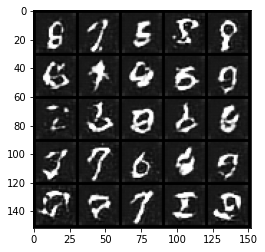

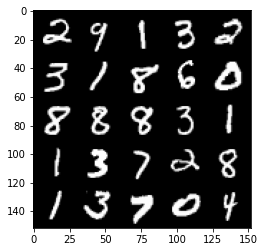

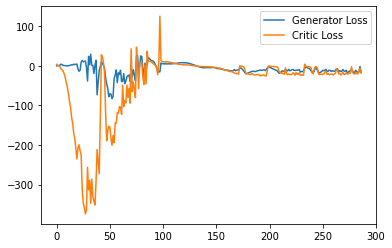

Step 5800: Generator loss: -17.960932822227477, critic loss: -18.430499864578252


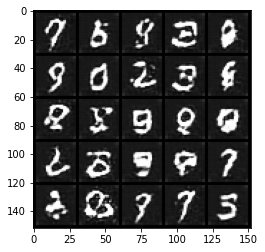

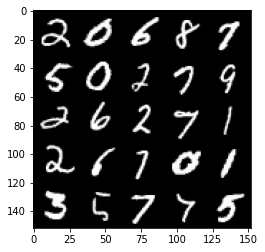

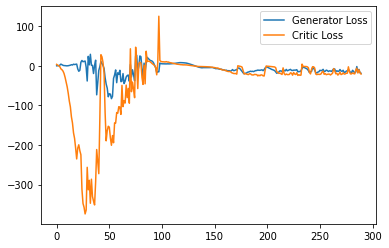

Step 5850: Generator loss: -15.519863702058792, critic loss: -18.676137550354007


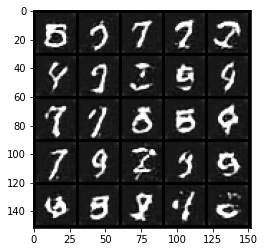

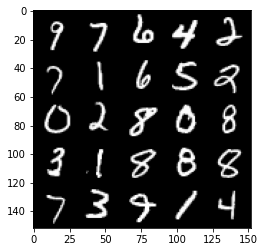

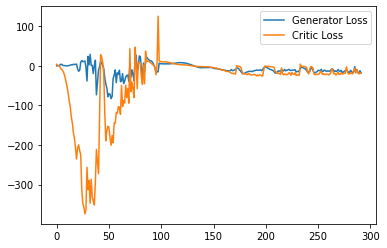

Step 5900: Generator loss: -14.908922422528267, critic loss: -14.49812010002136


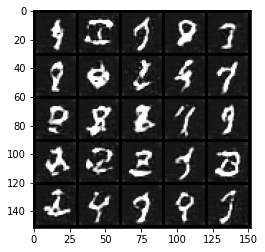

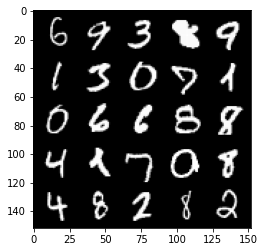

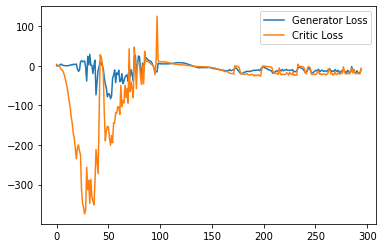

Step 5950: Generator loss: -16.62024922668934, critic loss: -15.590437052726736


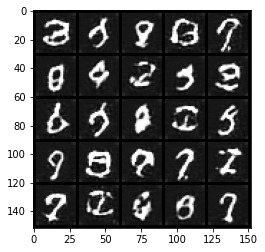

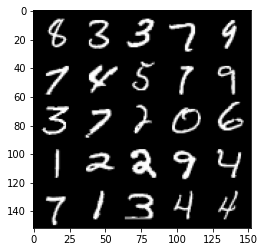

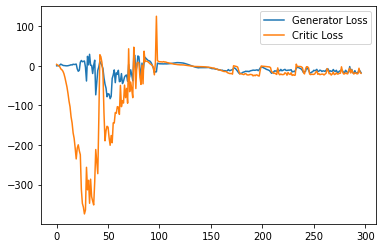

Step 6000: Generator loss: -18.974597778320312, critic loss: -22.48332796192169


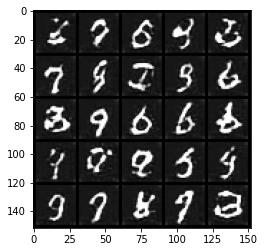

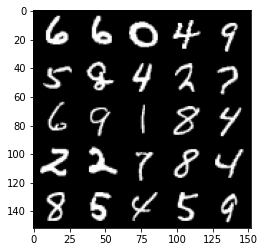

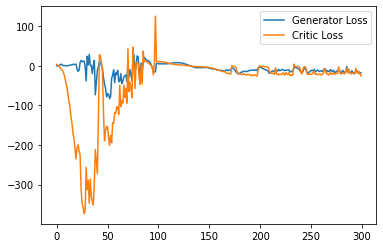

Step 6050: Generator loss: -17.624865326285363, critic loss: -19.32618914413452


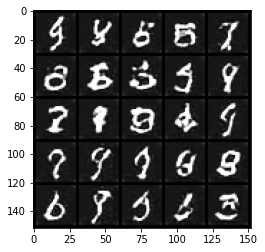

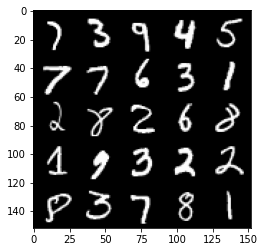

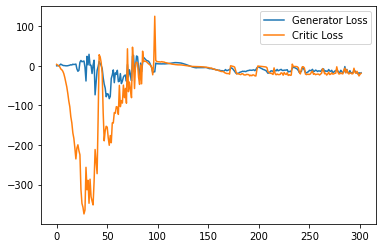

Step 6100: Generator loss: -17.89529515147209, critic loss: -19.80866531658173


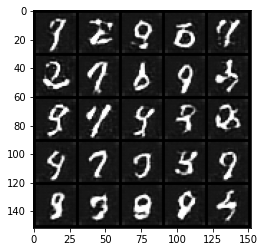

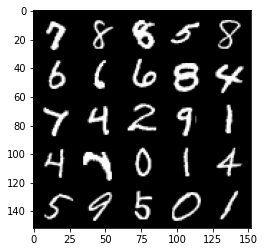

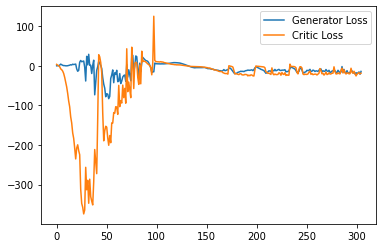

Step 6150: Generator loss: -11.36453556060791, critic loss: -6.124763556480408


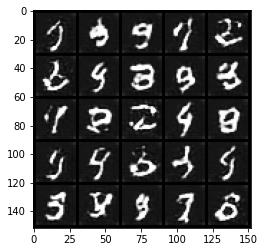

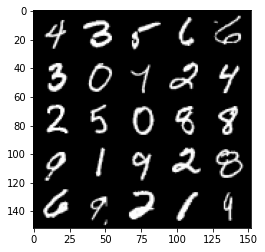

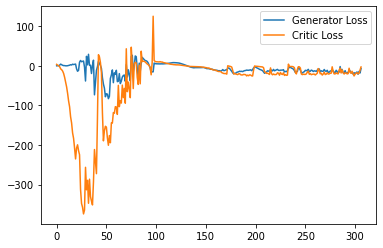

Step 6200: Generator loss: -17.868630771636962, critic loss: -14.197500895500179


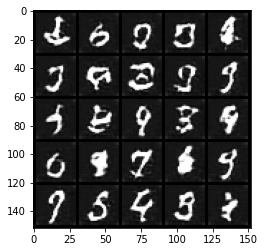

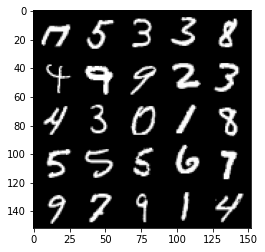

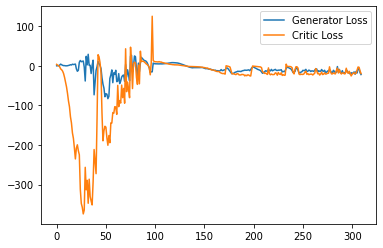

Step 6250: Generator loss: -14.380496665239335, critic loss: -7.786756055831911


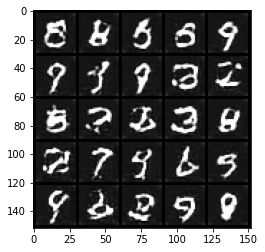

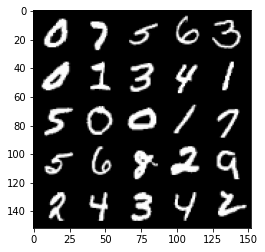

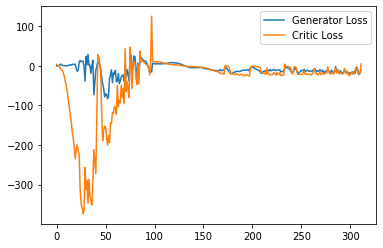

Step 6300: Generator loss: -23.523653316497803, critic loss: -15.955988622665402


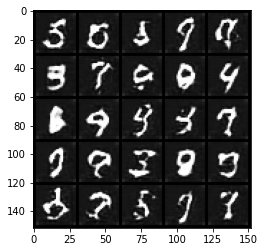

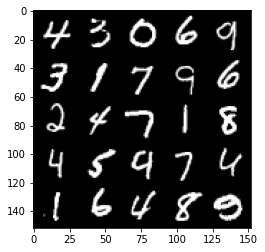

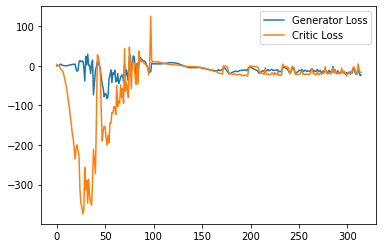

Step 6350: Generator loss: -14.196787147521972, critic loss: -10.95014709758758


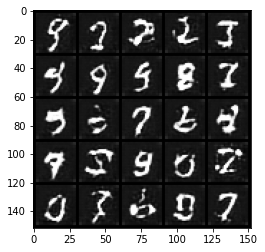

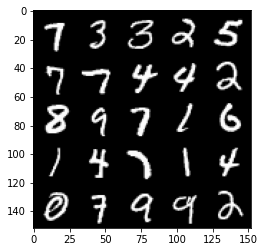

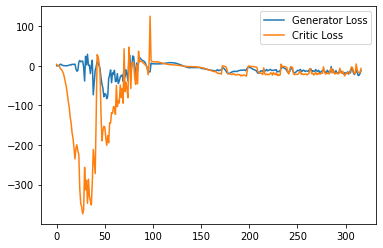

Step 6400: Generator loss: -19.222427921295164, critic loss: -15.873904515266416


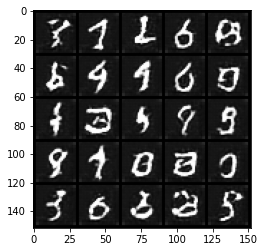

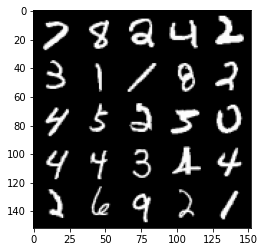

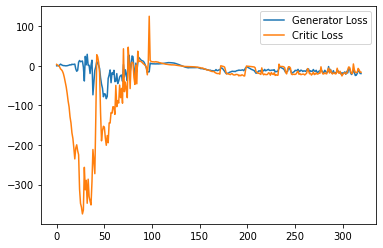

Step 6450: Generator loss: -17.41959234237671, critic loss: -15.554956300735476


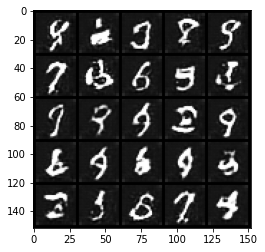

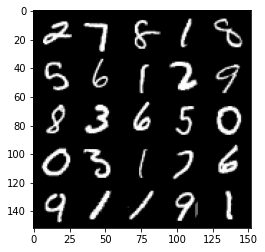

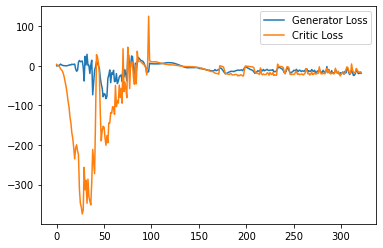

Step 6500: Generator loss: -14.791363587379456, critic loss: -8.363961667060853


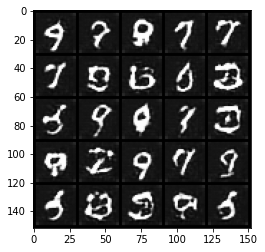

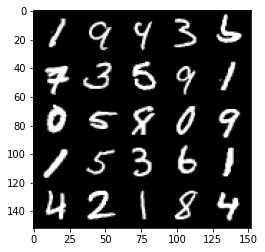

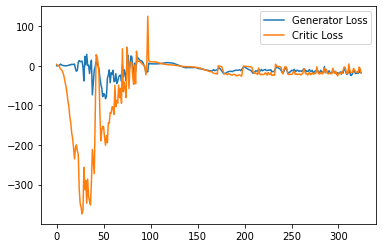

Step 6550: Generator loss: -14.880786989927293, critic loss: -14.827471731185913


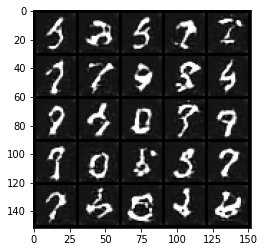

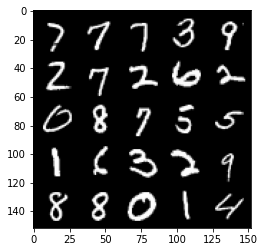

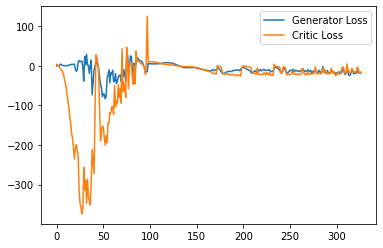

Step 6600: Generator loss: -15.931340262889861, critic loss: -14.580370319366457


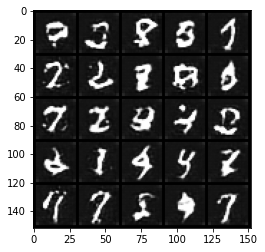

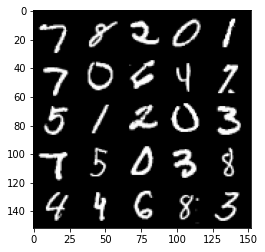

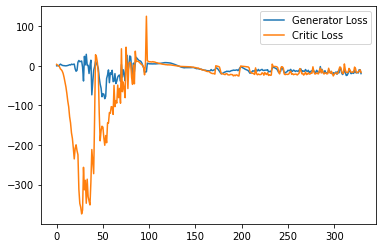

Step 6650: Generator loss: -19.03957156419754, critic loss: -14.788023544311518


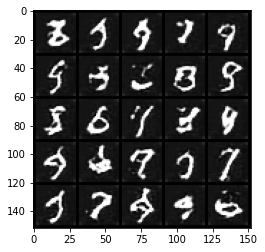

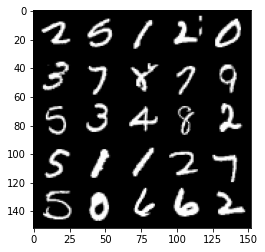

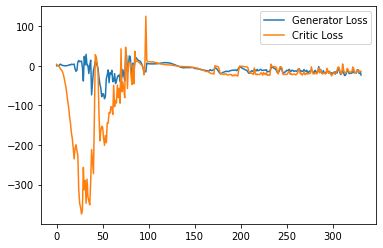

Step 6700: Generator loss: -15.783596441745757, critic loss: -13.180528202056882


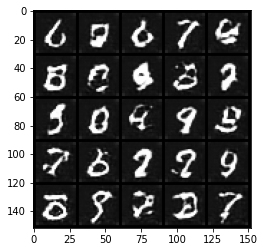

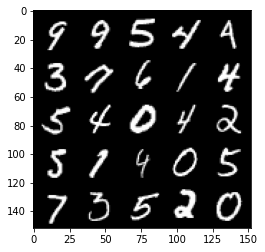

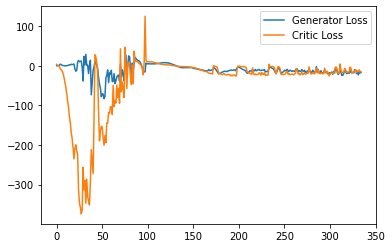

Step 6750: Generator loss: -16.659418157339097, critic loss: -15.953638599395752


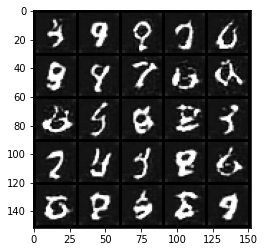

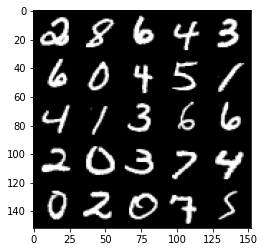

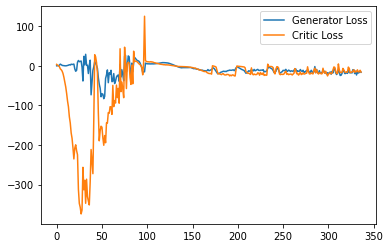

Step 6800: Generator loss: -21.898328236341477, critic loss: -16.255532749176023


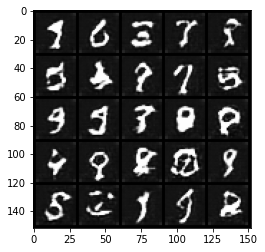

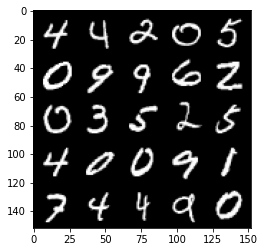

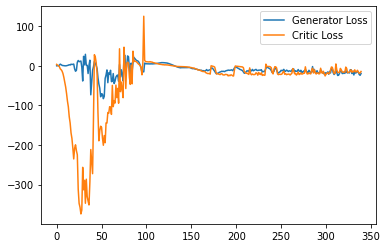

Step 6850: Generator loss: -18.24558526277542, critic loss: -14.31085215473175


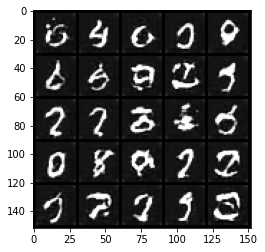

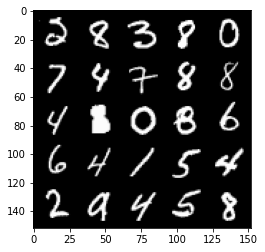

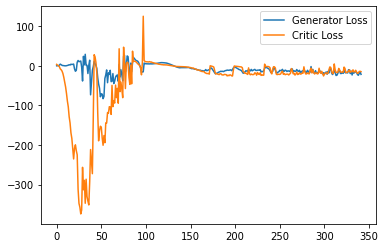

Step 6900: Generator loss: -19.20180332183838, critic loss: -15.778916744709015


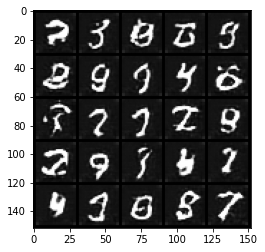

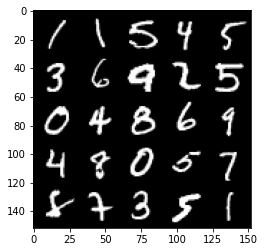

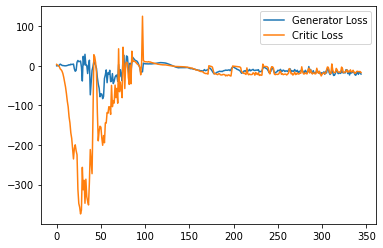

Step 6950: Generator loss: -21.706601753234864, critic loss: -17.159643626213075


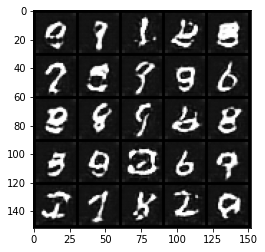

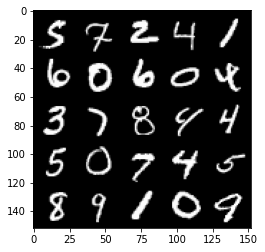

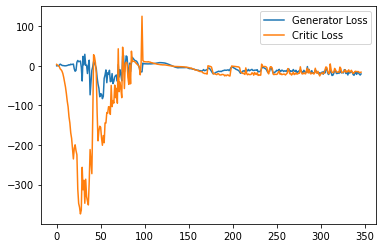

Step 7000: Generator loss: -16.923842453956603, critic loss: -14.625310048103326


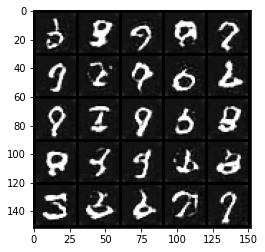

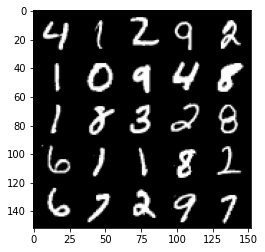

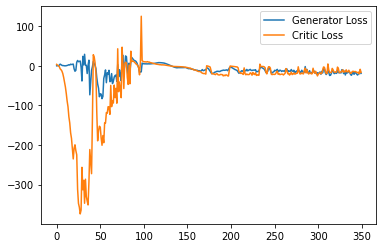

Step 7050: Generator loss: -20.328414402008057, critic loss: -12.482678960800172


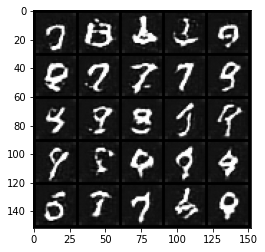

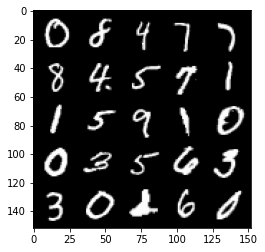

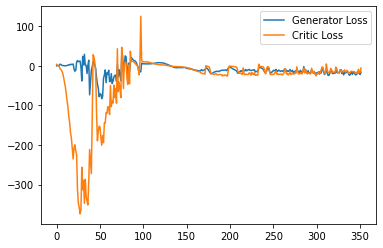

Step 7100: Generator loss: -18.98063006401062, critic loss: -15.222165681362146


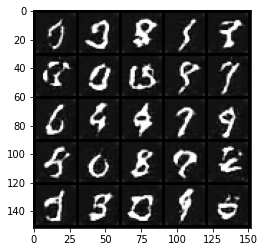

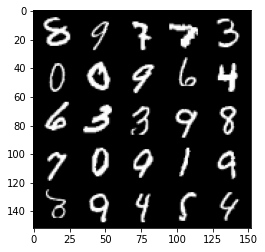

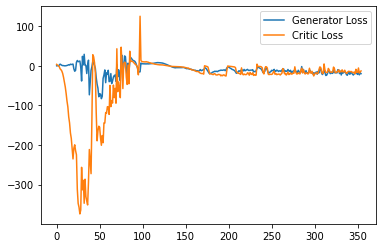

Step 7150: Generator loss: -19.59109127998352, critic loss: -16.369719065666203


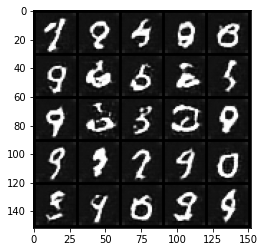

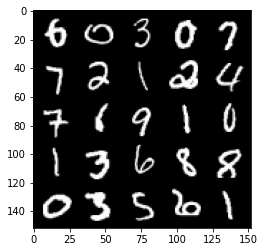

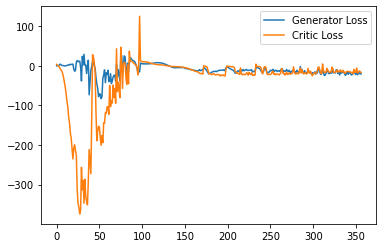

Step 7200: Generator loss: -17.306557750701906, critic loss: -15.445584017753609


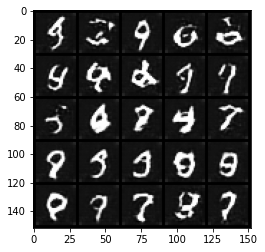

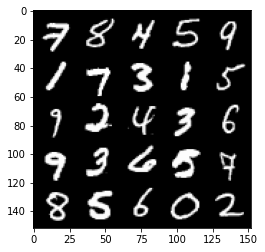

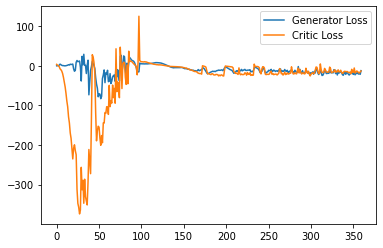

Step 7250: Generator loss: -15.495935096740723, critic loss: -12.097845950126652


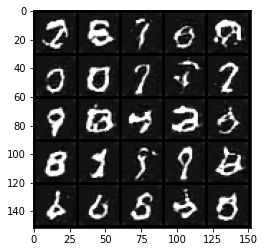

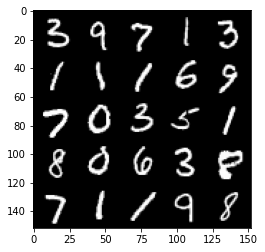

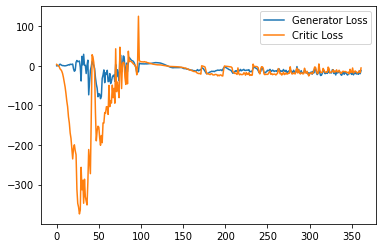

Step 7300: Generator loss: -17.70519910097122, critic loss: -17.592130093097694


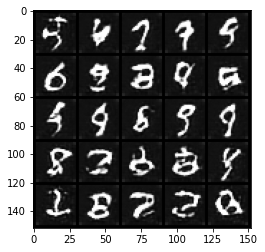

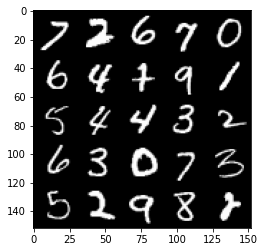

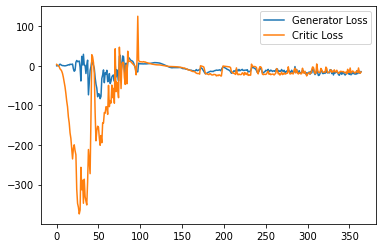

Step 7350: Generator loss: -18.09387521982193, critic loss: -14.034461227416989


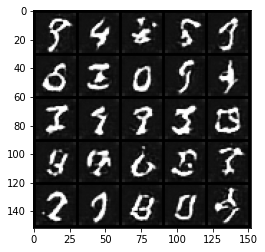

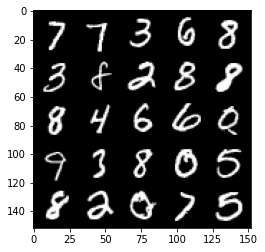

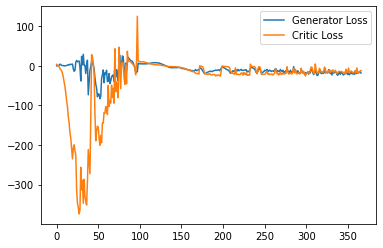

Step 7400: Generator loss: -20.74717209815979, critic loss: -17.977425815582272


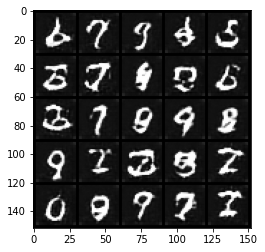

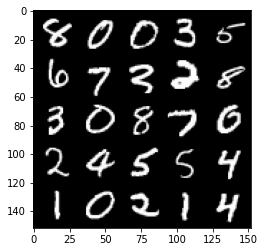

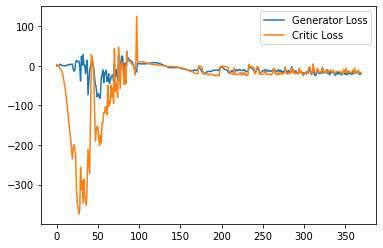

Step 7450: Generator loss: -15.030815680027008, critic loss: -12.794933000564576


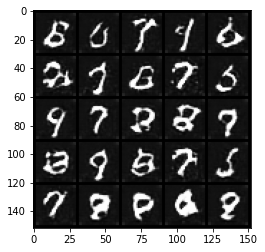

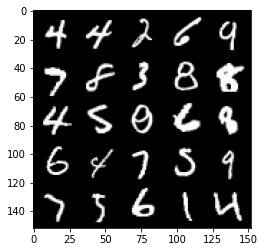

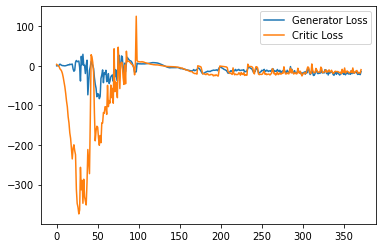

Step 7500: Generator loss: -19.23908358812332, critic loss: -17.10351937484741


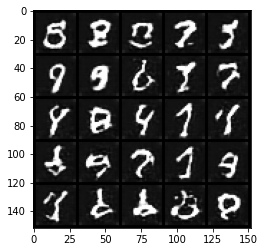

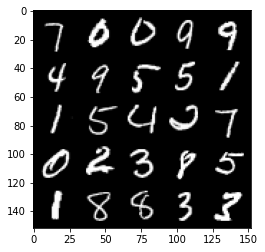

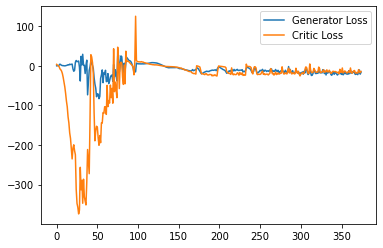

Step 7550: Generator loss: -13.446003583669663, critic loss: -11.806400729179382


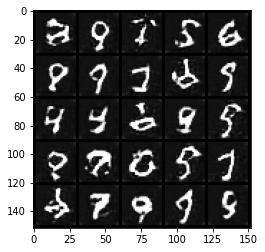

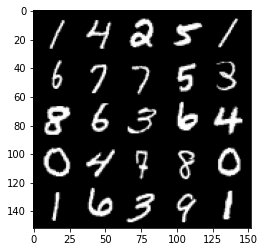

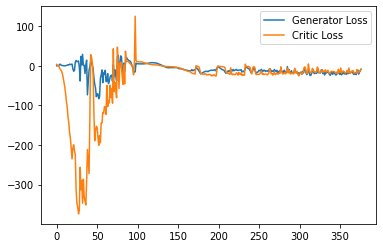

Step 7600: Generator loss: -19.144475326538085, critic loss: -17.22257312202453


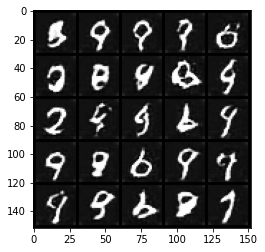

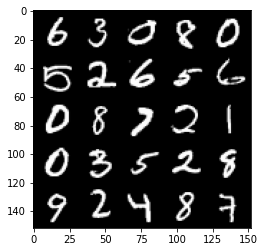

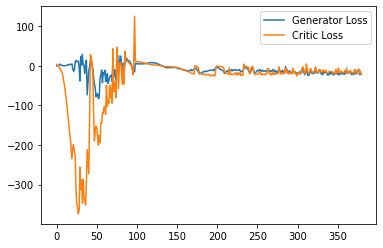

Step 7650: Generator loss: -16.663173491954804, critic loss: -13.350346115112304


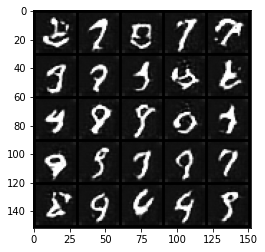

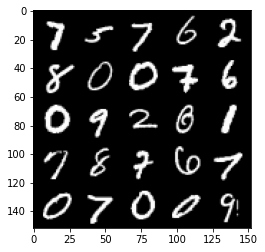

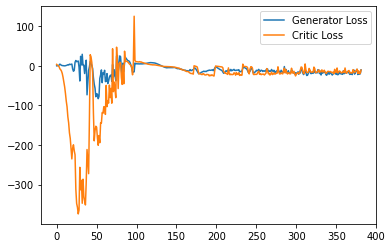

Step 7700: Generator loss: -19.171746323108675, critic loss: -15.91541612148285


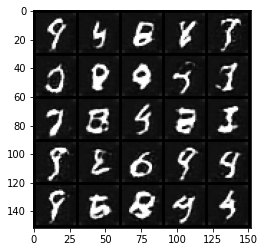

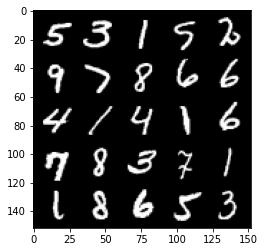

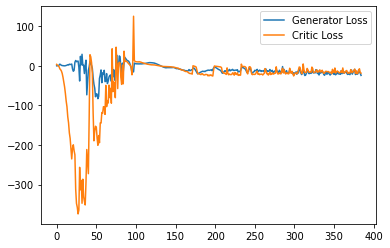

Step 7750: Generator loss: -14.192098282575607, critic loss: -14.850430787086486


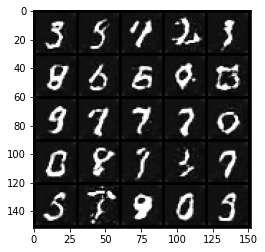

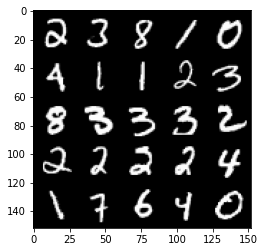

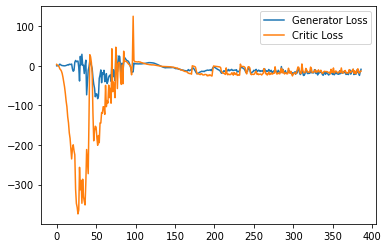

Step 7800: Generator loss: -16.22810552597046, critic loss: -10.319525815010072


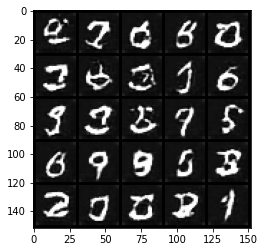

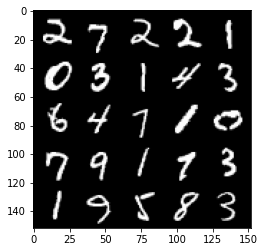

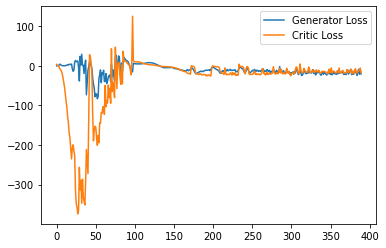

Step 7850: Generator loss: -20.708576889038085, critic loss: -18.55359702587128


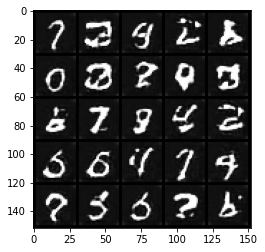

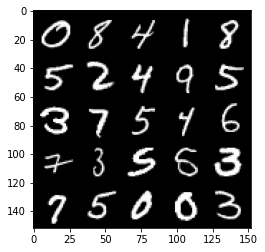

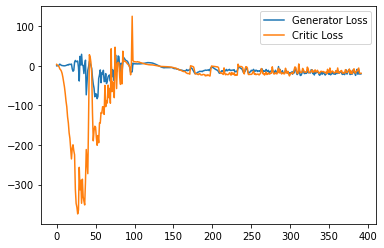

Step 7900: Generator loss: -16.76144879937172, critic loss: -15.574613554000848


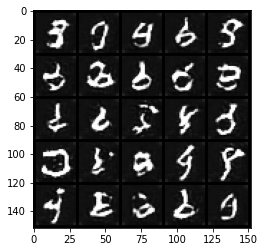

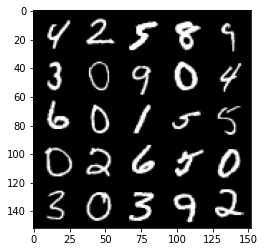

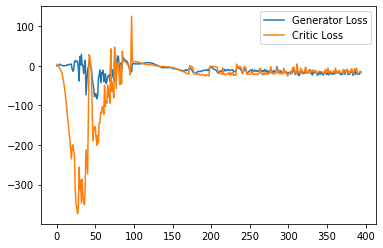

Step 7950: Generator loss: -16.520505611896514, critic loss: -18.590152729988098


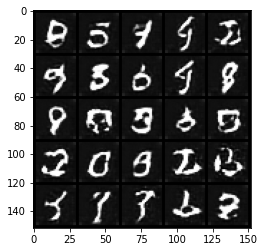

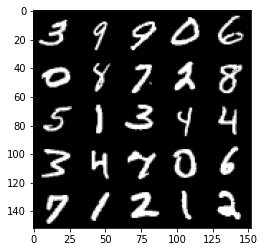

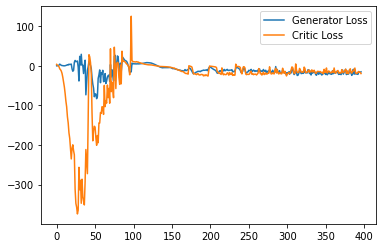

Step 8000: Generator loss: -14.969017221331596, critic loss: -15.134022867202761


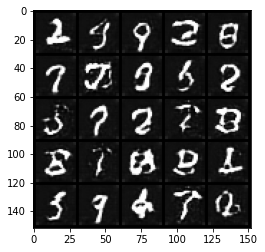

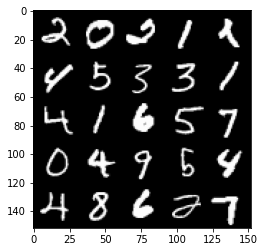

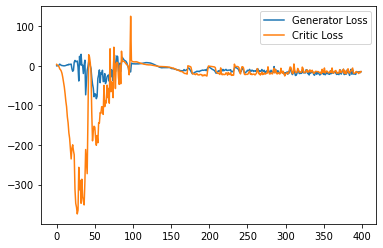

Step 8050: Generator loss: -14.014726697802544, critic loss: -17.723980486869813


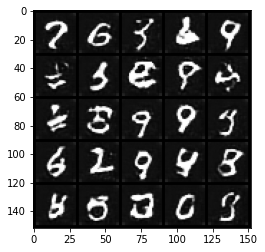

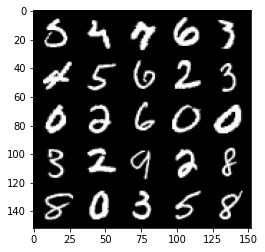

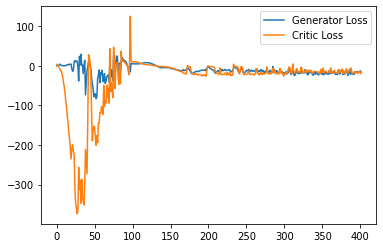

Step 8100: Generator loss: -14.42379165172577, critic loss: -4.729487378120427


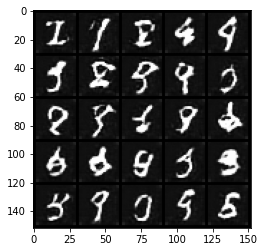

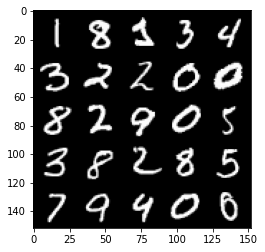

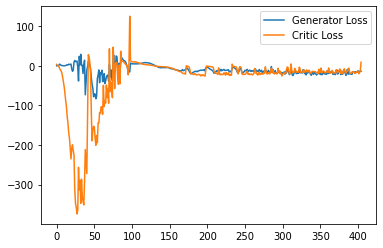

Step 8150: Generator loss: -5.253882751464844, critic loss: -2.107832728862763


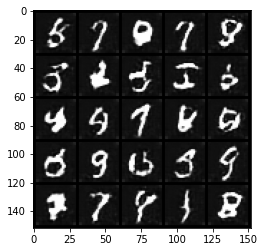

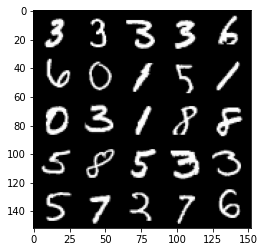

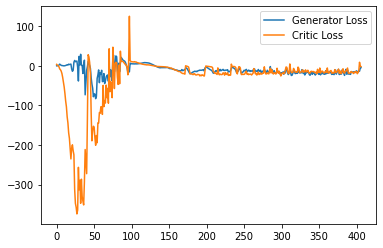

Step 8200: Generator loss: -5.715958499908448, critic loss: -2.3402931585311886


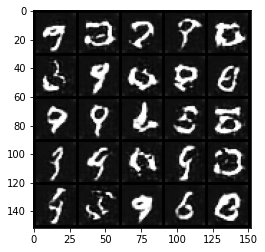

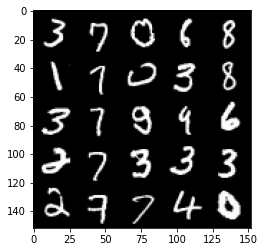

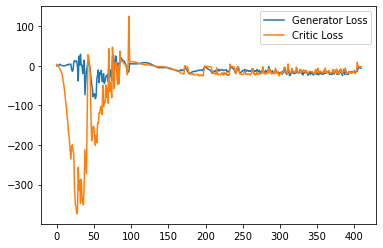

Step 8250: Generator loss: -7.322358083724976, critic loss: -2.423818651676178


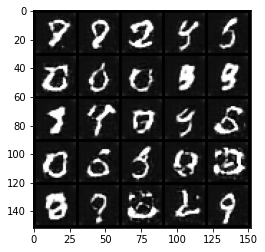

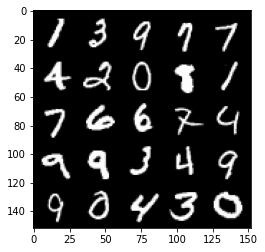

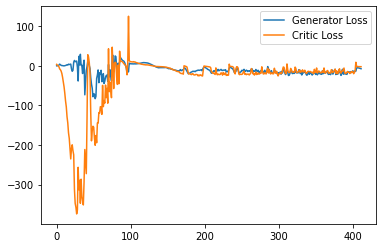

Step 8300: Generator loss: -8.785363693237304, critic loss: -2.645156864166259


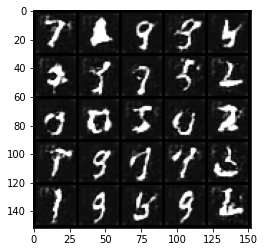

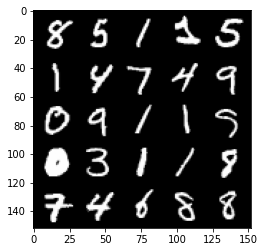

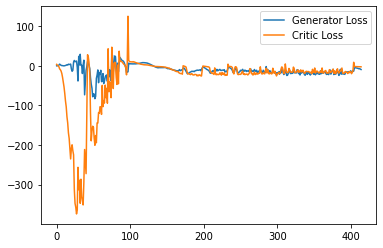

Step 8350: Generator loss: -11.552567119598388, critic loss: -3.4612880873680125


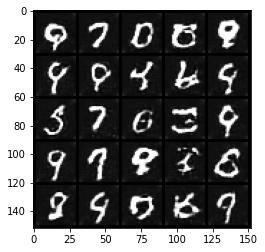

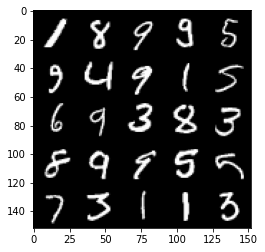

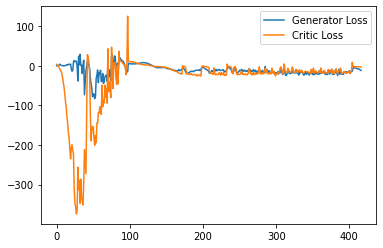

Step 8400: Generator loss: -9.345617259144783, critic loss: -5.386878240585327


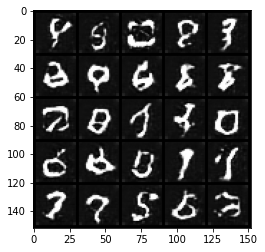

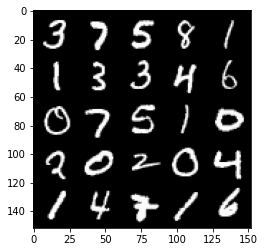

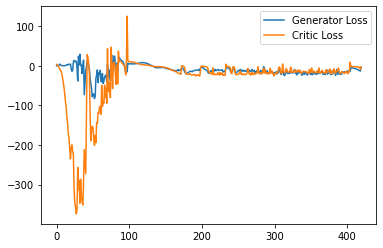

Step 8450: Generator loss: -14.165937051177025, critic loss: -13.409189298629762


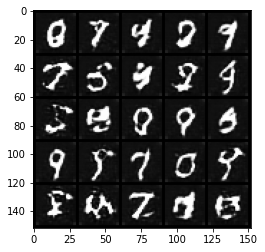

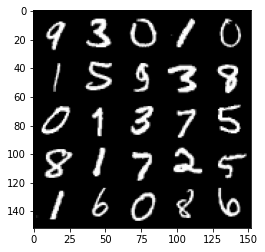

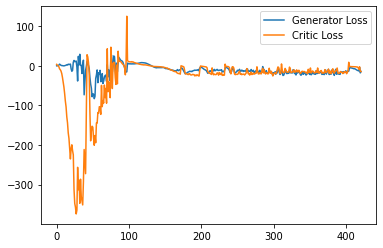

In [ ]:
step_i = 0
gen_losses = []
crit_losses = []

for epoch in range(n_epochs):
  # dataloader returns the batches
  for real_img, _ in tqdm(dataloader):
    batch_size_i = len(real_img)
    real_img = real_img.to(device)

    mean_iteration_crit_loss = 0
    for _ in range(crit_repeats):
      
      # update critic
      crit_opt.zero_grad()
      noise_vec = get_noise(batch_size_i, noise_dim, device)
      fake_img = gen(noise_vec)
      fake_pred = crit(fake_img.detach())
      real_pred = crit(real_img)

      epsilon = torch.rand(len(real_img), 1, 1, 1, device=device, requires_grad=True)
      gradient = get_grad(crit, real_img, fake_img.detach(), epsilon)
      gp = grad_penalty(gradient)
      crit_loss = get_crit_loss(fake_pred, real_pred, gp, lambda_i)

      # keep track of the average critic loss in this batch
      mean_iteration_crit_loss += crit_loss.item() / crit_repeats
      # update gradients
      crit_loss.backward(retain_graph = True)
      # update optimizer
      crit_opt.step()
    crit_losses += [mean_iteration_crit_loss]

    # update generator
    gen_opt.zero_grad()
    noise_vec_2 = get_noise(batch_size_i, noise_dim, device)
    fake_img_2 = gen(noise_vec_2)
    fake_pred = crit(fake_img_2)

    gen_loss = get_gen_loss(fake_pred)
    gen_loss.backward()
    gen_opt.step()

    # keep track of the average generator loss
    gen_losses += [gen_loss.item()]

    ## Visualization
    if step_i % viz_step == 0 and step_i > 0:
      gen_mean = sum(gen_losses[-viz_step:])/viz_step
      crit_mean = sum(crit_losses[-viz_step:])/viz_step
      print(f"Step {step_i}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
      tensor_image_viz(fake_img)
      tensor_image_viz(real_img)
      step_bins = 20
      num_examples = (len(gen_losses) // step_bins) * step_bins
      plt.plot(
          range(num_examples//step_bins),
          torch.Tensor(gen_losses[:num_examples]).view(-1, step_bins).mean(1),
          label='Generator Loss'
      )
      plt.plot(
          range(num_examples//step_bins),
          torch.Tensor(crit_losses[:num_examples]).view(-1, step_bins).mean(1),
          label='Critic Loss'
      )
      plt.legend()
      plt.show()

    step_i += 1
